In [1]:
import xarray as xr
import xesmf as xe
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import dask
import cftime
import random
import glob
import matplotlib.gridspec as gs

In [2]:
from dask.distributed import Client, LocalCluster
client = Client()
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: /proxy/8787/status,
Dashboard: /proxy/8787/status,Workers: 7
Total threads: 28,Total memory: 125.18 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:39109,Workers: 7
Dashboard: /proxy/8787/status,Total threads: 28
Started: Just now,Total memory: 125.18 GiB
Comm: tcp://127.0.0.1:41215,Total threads: 4
Dashboard: /proxy/38055/status,Memory: 17.88 GiB
Nanny: tcp://127.0.0.1:33319,


In [3]:
#get an index to calcualte the IOB
def ssta(DS):
    clim = DS.groupby('time.month').mean('time')
    ssta = DS.groupby('time.month') - clim
    return ssta
def NINO34(DS):
     return ssta(DS).sel(latitude=slice(-5, 5),longitude=slice(-170, -120)).mean(['latitude', 'longitude'])
     
def IOBM(DS):
    return ssta(DS).sel(latitude=slice(-20, 20),longitude=slice(40, 100)).mean(['latitude', 'longitude'])
def NINO34(DS):
    return ssta(DS).sel(latitude=slice(-5, 5),longitude=slice(-170, -120)).mean(['latitude', 'longitude'])
#calculate the DMI
def dmi(DS):
    WTIO = ssta(DS).sel(latitude=slice(-10, 10),longitude=slice(50, 70)).mean(['latitude', 'longitude'])
    SETIO = ssta(DS).sel(latitude=slice(-10, 0),longitude=slice(90, 110)).mean(['latitude', 'longitude'])
    return (WTIO-SETIO).drop('month')
def eio(DS):
    SETIO = ssta(DS).sel(latitude=slice(-10, 0),longitude=slice(90, 110)).mean(['latitude', 'longitude'])
    return (SETIO).drop('month')
def eio_1(DS):
    SETIO = (DS).sel(latitude=slice(-10, 0),longitude=slice(90, 110)).mean(['latitude', 'longitude'])
    return (SETIO)
def wio(DS):
    WTIO = ssta(DS).sel(latitude=slice(-10, 10),longitude=slice(50, 70)).mean(['latitude', 'longitude'])
    return (WTIO).drop('month')
def wio_1(DS):
    WTIO = (DS).sel(latitude=slice(-10, 10),longitude=slice(50, 70)).mean(['latitude', 'longitude'])
    return (WTIO)

In [4]:
def IOD_events(ds):
    #get the DMI timeseries in seaaons starting D(0)JF(1) etc
    QS = dmi(ds).resample(time='QS-DEC').mean(dim="time")
    #select SON seasons into a timeseries
    SON = QS.groupby('time.season')["SON"]
    #now use this to select all events and create da's of niod and piod event values
    lower,upper = SON.quantile([0.25, 0.75])
    nIOD = SON.where(SON <= lower.values).dropna(dim = "time")
    pIOD = SON.where(SON > upper.values).dropna(dim = "time")
    return nIOD, pIOD
def get_IOD_times(ds_sst, ds_var):
    nIOD, pIOD = IOD_events(ds_sst)
    #now get the times where the variable is in SON
    SON_var = ds_var.resample(time='QS-DEC').mean(dim="time").groupby('time.season')["SON"]
    #Now use nIOd and PIOD to get the times that we want
    nIOD_var = SON_var.where(SON_var.time == nIOD.time).dropna(dim = "time")
    pIOD_var = SON_var.where(SON_var.time == pIOD.time).dropna(dim = "time")
    return nIOD_var, pIOD_var

In [5]:
def regrid_ACCESS_u(ds, var):
    #rename coords
    ds = ds.rename({"geolon_c": "longitude", "geolat_c": "latitude"})
    #create the output grid
    ds_out = xe.util.grid_global(1, 1)
    ds_out = ds_out.drop({'lon_b', 'lat_b'})
    #rename grid coords
    ds_out = ds_out.rename({'lon': 'longitude', 'lat': 'latitude'})
    #drop the coords on input ds
    ds_in_1deg = ds.drop({'xu_ocean', 'yu_ocean'})
    #create regridder
    regridder_1deg = xe.Regridder(ds_in_1deg, ds_out, 'bilinear', periodic=True)
    #now regrid
    regridded = regridder_1deg(ds[var].chunk({'xu_ocean': -1, 'yu_ocean': -1}))
    regridded = regridded.assign_coords({'x': ds_out.longitude[0, :], 'y': ds_out.latitude[:, 0]})
    regridded = regridded.rename({'x': 'longitude', 'y': 'latitude'})
    return regridded

In [6]:
def regrid_ACCESS(ds, var):
    #rename coords
    ds = ds.rename({"geolon_t": "longitude", "geolat_t": "latitude"})
    #create the output grid
    ds_out = xe.util.grid_global(1, 1)
    ds_out = ds_out.drop({'lon_b', 'lat_b'})
    #rename grid coords
    ds_out = ds_out.rename({'lon': 'longitude', 'lat': 'latitude'})
    #drop the coords on input ds
    ds_in_1deg = ds.drop({'xt_ocean', 'yt_ocean'})
    #create regridder
    regridder_1deg = xe.Regridder(ds_in_1deg, ds_out, 'bilinear', periodic=True)
    #now regrid
    regridded = regridder_1deg(ds[var].chunk({'xt_ocean': -1, 'yt_ocean': -1}))
    regridded = regridded.assign_coords({'x': ds_out.longitude[0, :], 'y': ds_out.latitude[:, 0]})
    regridded = regridded.rename({'x': 'longitude', 'y': 'latitude'})
    return regridded

In [7]:
ctrl_sst = xr.open_dataset("/g/data/e14/sm2435/Exps_ACCESS_initial/ctrl_sst.nc",  use_cftime=True, chunks= {"time":240})
VC = xr.open_dataset("/g/data/e14/sm2435/Exps_ACCESS_initial/VAR_PACE_sst.nc",  use_cftime=True, chunks= {"time":240})
MC = xr.open_dataset("/g/data/e14/sm2435/Exps_ACCESS_initial/MC_sst.nc",  use_cftime=True, chunks= {"time":240})
OC = xr.open_dataset("/g/data/e14/sm2435/Exps_ACCESS_initial/OC_sst.nc",  use_cftime=True, chunks= {"time":240})

In [8]:
#VC = regrid_ACCESS(VC, 'sst')
VC = VC.sst.compute()

In [9]:
#MC = regrid_ACCESS(MC, 'sst')
MC = MC.sst.compute()

In [10]:
#OC = regrid_ACCESS(OC, 'sst')
OC = OC.sst.compute()

In [12]:
#ctrl = regrid_ACCESS(ctrl_sst, 'sst')
ctrl = ctrl_sst.sst.compute()

In [13]:
def regrid_ACCESS_atmos(ds, var):
    #rename coords
    ds = ds.rename({"lon": "longitude", "lat": "latitude"})
    #create the output grid
    ds_out = xe.util.grid_global(1, 1)
    ds_out = ds_out.drop({'lon_b', 'lat_b'})
    #rename grid coords
    ds_out = ds_out.rename({'lon': 'longitude', 'lat': 'latitude'})
    #drop the coords on input ds
    #ds_in_1deg = ds.drop({'xt_ocean', 'yt_ocean'})
    #create regridder
    regridder_1deg = xe.Regridder(ds, ds_out, 'bilinear', periodic=True)
    #now regrid
    regridded = regridder_1deg(ds[var])#.chunk({'xt_ocean': -1, 'yt_ocean': -1}))
    regridded = regridded.assign_coords({'x': ds_out.longitude[0, :], 'y': ds_out.latitude[:, 0]})
    regridded = regridded.rename({'x': 'longitude', 'y': 'latitude'})
    return regridded

In [14]:
VC_pr = xr.open_mfdataset("/g/data/e14/sm2435/Exps_ACCESS_initial/VC_pr/VC_pr*.nc",
                          use_cftime=True, chunks= {"time":240})
OC_pr = xr.open_mfdataset("/g/data/e14/sm2435/Exps_ACCESS_initial/OC_pr/OC_pr*.nc",
                          use_cftime=True, chunks= {"time":240})
MC_pr = xr.open_mfdataset("/g/data/e14/sm2435/Exps_ACCESS_initial/MC_pr/MC_pr*.nc",
                          use_cftime=True, chunks= {"time":240})
ctrl_pr = xr.open_mfdataset("/g/data/e14/sm2435/Exps_ACCESS_initial/ctrl_pr/ctrl_pr*.nc",
                          use_cftime=True, chunks= {"time":240})


In [15]:
ctrl_pr = regrid_ACCESS_atmos(ctrl_pr, 'fld_s05i216')
ctrl_pr = ctrl_pr.compute()

In [16]:
OC_pr = regrid_ACCESS_atmos(OC_pr, 'fld_s05i216')
OC_pr = OC_pr.compute()

In [17]:
MC_pr = regrid_ACCESS_atmos(MC_pr, 'fld_s05i216')
MC_pr = MC_pr.compute()

In [18]:
VC_pr = regrid_ACCESS_atmos(VC_pr, 'fld_s05i216')
VC_pr = VC_pr.compute()

In [19]:
VC_psl = xr.open_mfdataset("/g/data/e14/sm2435/Exps_ACCESS_initial/VC_psl/VC_pr*.nc",
                          use_cftime=True, chunks= {"time":240})
OC_psl = xr.open_mfdataset("/g/data/e14/sm2435/Exps_ACCESS_initial/OC_psl/OC_pr*.nc",
                          use_cftime=True, chunks= {"time":240})
MC_psl = xr.open_mfdataset("/g/data/e14/sm2435/Exps_ACCESS_initial/MC_psl/MC_pr*.nc",
                          use_cftime=True, chunks= {"time":240})
ctrl_psl = xr.open_mfdataset("/g/data/e14/sm2435/Exps_ACCESS_initial/ctrl_psl/ctrl_pr*.nc",
                          use_cftime=True, chunks= {"time":240})


In [20]:
ctrl_psl = regrid_ACCESS_atmos(ctrl_psl, 'fld_s00i409')
ctrl_psl = ctrl_psl.compute()

In [21]:
OC_psl = regrid_ACCESS_atmos(OC_psl, 'fld_s00i409')
OC_psl = OC_psl.compute()

In [22]:
MC_psl = regrid_ACCESS_atmos(MC_psl, 'fld_s00i409')
MC_psl = MC_psl.compute()

In [23]:
VC_psl = regrid_ACCESS_atmos(VC_psl, 'fld_s00i409')
VC_psl = VC_psl.compute()

In [24]:
data_dir = "/g/data/e14/sm2435/Exps_ACCESS_initial/"

In [25]:
ctrl_z20 = xr.open_dataset(data_dir+"ctrl_z20.nc", use_cftime=True, chunks= {"time":240})

In [26]:
ctrl_z20 = regrid_ACCESS(ctrl_z20, 'z20')
ctrl_z20 = ctrl_z20.compute()

In [27]:
VC_z20 = xr.open_dataset(data_dir+"Var_pace_z20.nc", use_cftime=True, chunks= {"time":240})

In [28]:
OC_z20 = xr.open_dataset(data_dir+"obs_pace_z20.nc", use_cftime=True, chunks= {"time":240})

In [29]:
MC_z20 = xr.open_dataset(data_dir+"mod_pace_z20.nc", use_cftime=True, chunks= {"time":240})

In [30]:
OC_z20 = regrid_ACCESS(OC_z20, 'z20')
OC_z20 = OC_z20.compute()

In [31]:
VC_z20 = regrid_ACCESS(VC_z20, 'z20')
VC_z20 = VC_z20.compute()

In [32]:
MC_z20 = regrid_ACCESS(MC_z20, 'z20')
MC_z20 = MC_z20.compute()

In [33]:
ctrl_u = xr.open_dataset(data_dir+"ctrl_uwnd.nc", use_cftime=True, chunks= {"time":240})

In [34]:
ctrl_u = regrid_ACCESS_u(ctrl_u, 'tauu')
ctrl_u = ctrl_u.compute()

In [35]:
ctrl_v = xr.open_dataset(data_dir+"ctrl_vwnd.nc", use_cftime=True, chunks= {"time":240})

In [36]:
ctrl_v = regrid_ACCESS_u(ctrl_v, 'tauv')
ctrl_v = ctrl_v.compute()

In [37]:
VC_u = xr.open_dataset(data_dir+"var_uwnd.nc", use_cftime=True, chunks= {"time":240})
VC_u = regrid_ACCESS_u(VC_u, 'tauu')
VC_u = VC_u.compute()

In [38]:
VC_v = xr.open_dataset(data_dir+"var_vwnd.nc", use_cftime=True, chunks= {"time":240})
VC_v = regrid_ACCESS_u(VC_v, 'tauv')
VC_v = VC_v.compute()

In [39]:
OC_u = xr.open_dataset(data_dir+"ob_uwnd.nc", use_cftime=True, chunks= {"time":240})
OC_u = regrid_ACCESS_u(OC_u, 'tauu')
OC_u = OC_u.compute()

In [40]:
OC_v = xr.open_dataset(data_dir+"ob_vwnd.nc", use_cftime=True, chunks= {"time":240})
OC_v = regrid_ACCESS_u(OC_v, 'tauv')
OC_v = OC_v.compute()

In [41]:
MC_v = xr.open_dataset(data_dir+"mod_vwnd.nc", use_cftime=True, chunks= {"time":240})
MC_v = regrid_ACCESS_u(MC_v, 'tauv')
MC_v = MC_v.compute()

In [42]:
MC_u = xr.open_dataset(data_dir+"mod_uwnd.nc", use_cftime=True, chunks= {"time":240})
MC_u = regrid_ACCESS_u(MC_u, 'tauu')
MC_u = MC_u.compute()

In [43]:
MC = MC.sel(time = slice("0951-01-01", "1050-12-31"))
MC_u = MC_u.sel(time = slice("0951-01-01", "1050-12-31"))
MC_v = MC_v.sel(time = slice("0951-01-01", "1050-12-31"))
MC_z20 = MC_z20.sel(time = slice("0951-01-01", "1050-12-31"))

In [44]:
ctrl = ctrl.sel(time = slice("0951-01-01", "1150-12-31"))
ctrl_u = ctrl_u.sel(time = slice("0951-01-01", "1150-12-31"))
ctrl_v = ctrl_v.sel(time = slice("0951-01-01", "1150-12-31"))
ctrl_z20 = ctrl_z20.sel(time = slice("0951-01-01", "1150-12-31"))

In [45]:
ctrl = ctrl.sel(time = slice("0951-01-01", "1150-12-31"))
MC = MC.sel(time = slice("0951-01-01", "1050-12-31"))

In [46]:
#convert the precip data from proleptic gregorian to gregorian
ctrl_pr.coords['time'] = ctrl.time
MC_pr.coords['time'] = MC.time
OC_pr.coords['time'] = OC.time
VC_pr.coords['time'] = VC.time

ValueError: conflicting sizes for dimension 'time': length 600 on <this-array> and length 840 on {'time': 'time', 'longitude': 'longitude', 'latitude': 'latitude'}

In [ ]:
def IOD_events(ds):
    #get the DMI timeseries in seaaons starting D(0)JF(1) etc
    QS = dmi(ds).resample(time='QS-DEC').mean(dim="time")
    #select SON seasons into a timeseries
    SON = QS.groupby('time.season')["SON"]
    #now use this to select all events and create da's of niod and piod event values
    lower,upper = SON.quantile([0.25, 0.75])
    nIOD = SON.where(SON <= lower.values).dropna(dim = "time")
    pIOD = SON.where(SON > upper.values).dropna(dim = "time")
    return nIOD, pIOD
def get_IOD_times(ds_sst, ds_var):
    nIOD, pIOD = IOD_events(ds_sst)
    #now get the times where the variable is in SON
    SON_var = ds_var.resample(time='QS-DEC').mean(dim="time").groupby('time.season')["SON"]
    #Now use nIOd and PIOD to get the times that we want
    nIOD_var = SON_var.where(SON_var.time == nIOD.time).dropna(dim = "time")
    pIOD_var = SON_var.where(SON_var.time == pIOD.time).dropna(dim = "time")
    return nIOD_var, pIOD_var

In [ ]:
def get_IOD_times(ds_sst, ds_var):
    nIOD, pIOD = IOD_events(ds_sst)
    nIOD = nIOD.groupby("time.year").mean("time").year
    pIOD = pIOD.groupby("time.year").mean("time").year
    #now get the ds_var groupbed by year for each season. 
    ds_var = ds_var.resample(time='QS-DEC').mean(dim="time").groupby("time.year")
    # Initialize an empty list to store the subsets
    pos_list = []
    neg_list = []
    # Loop through each year group in ds_var and subset based on the specific years in both nIOD and pIOD
    for year, group in ds_var:
        if year in pIOD:
            pos_subset = group
            pos_list.append(pos_subset)
        elif year in nIOD:
            neg_subset = group
            neg_list.append(neg_subset)
        else:
            pass
    # Combine the subsets into a single DataArray
    subset_ds_pos = xr.concat(pos_list, dim='time')
    subset_ds_neg = xr.concat(neg_list, dim='time')
    return subset_ds_pos, subset_ds_neg

In [ ]:
p_VCpr, n_VCpr = get_IOD_times(VC, VC_pr)
p_VC, n_VC = get_IOD_times(VC, VC)
#p_VCz20, n_VCz20 = get_IOD_times(VC, VC_z20)

In [ ]:
p_OCpr, n_OCpr = get_IOD_times(OC, OC_pr)
p_OC, n_OC = get_IOD_times(OC, OC)
#p_OCz20, n_OCz20 = get_IOD_times(OC, OC_z20)

In [ ]:
p_MCpr, n_MCpr = get_IOD_times(MC,MC_pr)
p_MC, n_MC = get_IOD_times(MC, MC)
#p_MCz20, n_MCz20 = get_IOD_times(MC, MC_z20)

In [ ]:
p_ctrlpr, n_ctrlpr = get_IOD_times(ctrl, ctrl_pr)
p_ctrl, n_ctrl = get_IOD_times(ctrl, ctrl)
#p_ctrlz20, n_ctrlz20 = get_IOD_times(ctrl, ctrl_z20)

In [ ]:
from scipy.stats import ttest_ind

In [ ]:
def plot_bias_sig_annual(ctrl, exp, temp_scale=2):
    ctrl_mn = ctrl.mean('time')
    exp_mn = exp.mean("time")
    # Now calculate significance for annual component
    dims = ('latitude', 'longitude')
    t_stat, p_value = ttest_ind(exp, ctrl)
    t_stat_ds = xr.DataArray(t_stat, dims=dims, coords={dim: exp.coords[dim] for dim in dims})
    p_value_ds = xr.DataArray(p_value, dims=dims, coords={dim: exp.coords[dim] for dim in dims})
    sig_p = p_value_ds.where(p_value_ds < 0.05, np.nan)
    
    # Now plot figure
    plt.figure(figsize=(12, 4))
    ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))

    # Set extent for longitude and latitude if provided
    ax.set_extent([30, 290, -30, 30], crs=ccrs.PlateCarree())

    bias = (exp_mn - ctrl_mn)
    bias.plot.contourf(ax=ax, vmin=-1*temp_scale, vmax=temp_scale, cmap="BrBG", levels=10, extend='both',
                       transform=ccrs.PlateCarree(), cbar_kwargs=dict(label=''))

    ax.coastlines(color='k')
    ax.axhline(y=-15, color='black', linestyle='--', linewidth=1)  # 15S
    ax.axhline(y=15, color='black', linestyle='--', linewidth=1)
    ax.gridlines()
    
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
   
    # Plot significance
    ax.contourf(sig_p.longitude, sig_p.latitude, sig_p, levels=[0, 0.05],
                hatches=['///'], alpha=0.0, add_colorbar=False, transform=ccrs.PlateCarree())
    
    return

In [47]:
def plot_bias_sig_annual(ctrl, exp, temp_scale=20):
    ctrl_mn = ctrl.groupby("time.season")["SON"].mean('time')
    exp_mn = exp.groupby("time.season")["SON"].mean("time")
    # Now calculate significance for annual component
    #dims = ('latitude', 'longitude')
    #t_stat, p_value = ttest_ind(exp, ctrl)
    #t_stat_ds = xr.DataArray(t_stat, dims=dims, coords={dim: exp.coords[dim] for dim in dims})
    #p_value_ds = xr.DataArray(p_value, dims=dims, coords={dim: exp.coords[dim] for dim in dims})
    #sig_p = p_value_ds.where(p_value_ds < 0.05, np.nan)
    
    # Now plot figure
    plt.figure(figsize=(12, 4))
    ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))

    # Set extent for longitude and latitude if provided
    ax.set_extent([30, 290, -30, 30], crs=ccrs.PlateCarree())

    bias = (exp_mn - ctrl_mn)
    bias.plot.contourf(ax=ax, vmin=-1*temp_scale, vmax=temp_scale, cmap="RdBu_r", levels=10, extend='both',
                       transform=ccrs.PlateCarree(), cbar_kwargs=dict(label=' '))

    ax.coastlines(color='k')
    ax.axhline(y=-15, color='black', linestyle='--', linewidth=1)  # 15S
    ax.axhline(y=15, color='black', linestyle='--', linewidth=1)
    ax.gridlines()
    
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
   
    # Plot significance
    #ax.contourf(sig_p.longitude, sig_p.latitude, sig_p, levels=[0, 0.05],
    #            hatches=['///'], alpha=0.0, add_colorbar=False, transform=ccrs.PlateCarree())
    
    return


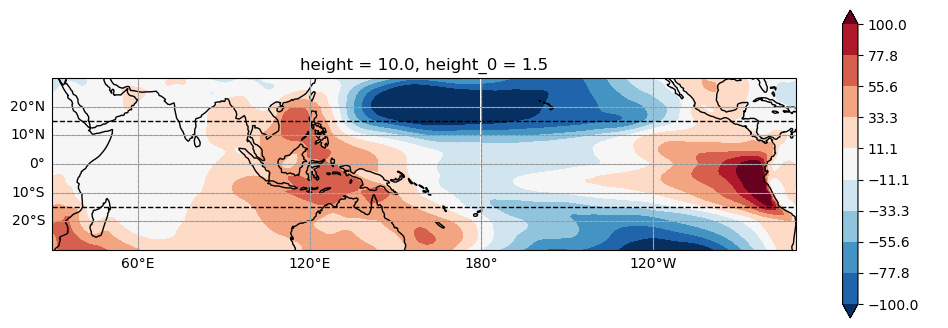

In [48]:
plot_bias_sig_annual(ctrl_psl, VC_psl, temp_scale=100)

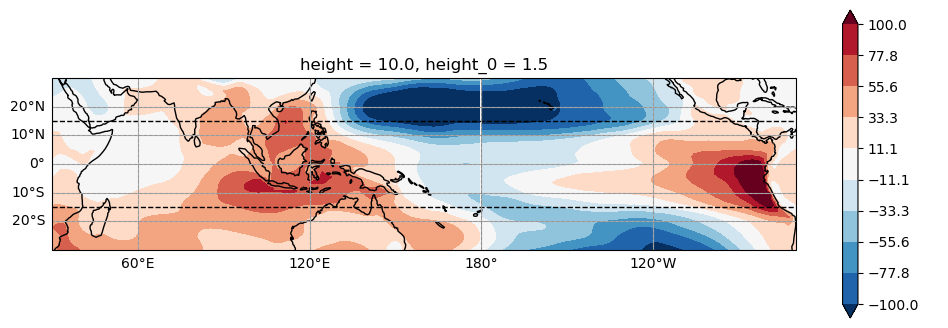

In [49]:
plot_bias_sig_annual(ctrl_psl, OC_psl, temp_scale=100)

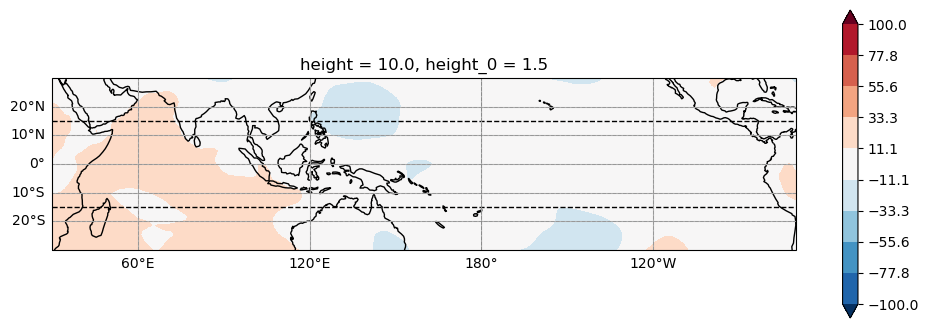

In [50]:
plot_bias_sig_annual(ctrl_psl, MC_psl, temp_scale=100)

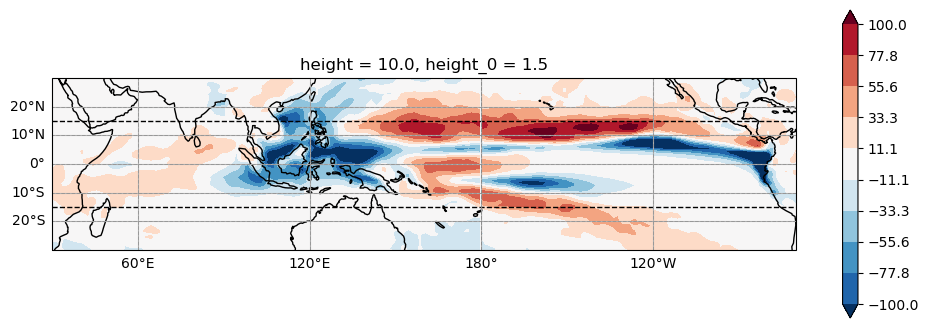

In [51]:
plot_bias_sig_annual(ctrl_pr*30*86400, VC_pr*30*86400, temp_scale=100)

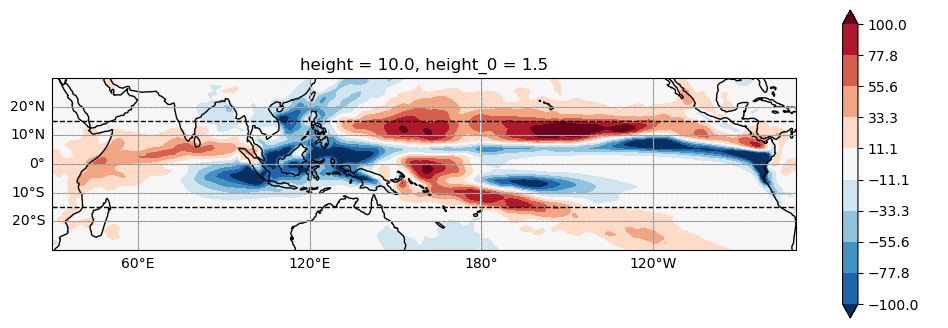

In [52]:
plot_bias_sig_annual(ctrl_pr*30*86400, OC_pr*30*86400, temp_scale=100)

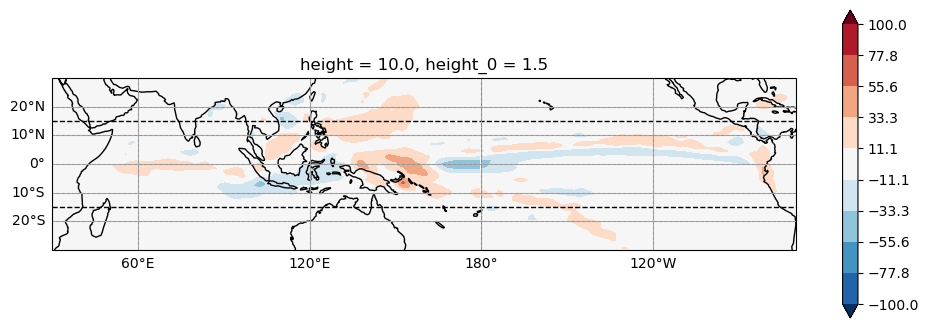

In [53]:
plot_bias_sig_annual(ctrl_pr*30*86400, MC_pr*30*86400, temp_scale=100)

In [ ]:
def plot_diff(p_var, p_ctrl, scale):
    fg = ((p_var.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time') - 
            p_ctrl.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))).plot.contourf(
        col = "month", col_wrap = 2,levels = 16,vmin = -scale, vmax = scale, cmap = "BrBG", extend = "both",
            transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                                  figsize=(20,8))
    titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
    i=0
    for ax,title in zip(fg.axs.flatten(),titles):
        ax.set_title(title )
        ax.coastlines()
        gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

        if i in [0,1]:
            gl.bottom_labels = False
        if i in [1,3]:
            gl.left_labels = False
        gl.top_labels = False
        gl.right_labels = False
        i = i+1
    return

In [ ]:
def plot_annual(ds1,ds2, scale):
    plt.figure(figsize = (20,8))
    ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
    (ds1.mean("time")-ds2.mean("time")).plot.contourf(transform=ccrs.PlateCarree(), 
                                                      levels = 16,vmin = -scale, vmax = scale, cmap = "BrBG", extend = "both")
    ax.coastlines(color = 'k')
    ax.axhline(y=-15, color='black', linestyle='--', linewidth=1)  # 15S
    ax.axhline(y=15, color='black', linestyle='--', linewidth=1)
    ax.gridlines()
    #ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                          linewidth=0.7, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    return

In [ ]:
def plot_IOD_anoms(p_var, n_var, p_ctrl, n_ctrl, scale):
    fg = ((p_var.groupby('time.month').mean('time') - 
            p_ctrl.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))).plot.contourf(
        col = "month", col_wrap = 2,levels = 16,vmin = -scale, vmax = scale, cmap = "RdBu_r", extend = "both",
            transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                                  figsize=(20,8))
    titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
    for ax,title in zip(fg.axs.flatten(),titles):
        ax.set_title(title )
        ax.coastlines()
    fg1 = ((n_var.groupby('time.month').mean('time') - 
            n_ctrl.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))).plot.contourf(
        col = "month", col_wrap = 2,levels = 16,vmin = -scale, vmax = scale, cmap = "RdBu_r", extend = "both",
            transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                                  figsize=(20,8))
    titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
    for ax,title in zip(fg1.axs.flatten(),titles):
        ax.set_title(title )
        ax.coastlines()     
        
    return
    

In [51]:
#Find latitude of max rainfall in 180-90W

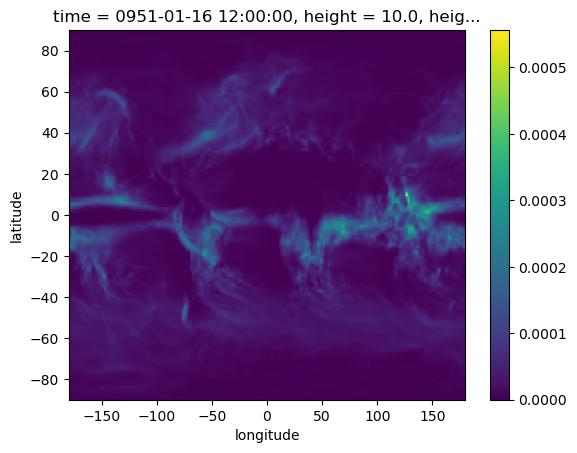

In [54]:
ctrl_pr[0].plot()

In [56]:
test = ctrl_pr.sel(longitude = slice(-180, -90))

Text(0.5, 1.0, 'Latitude of max precipitation (180W-90W)')

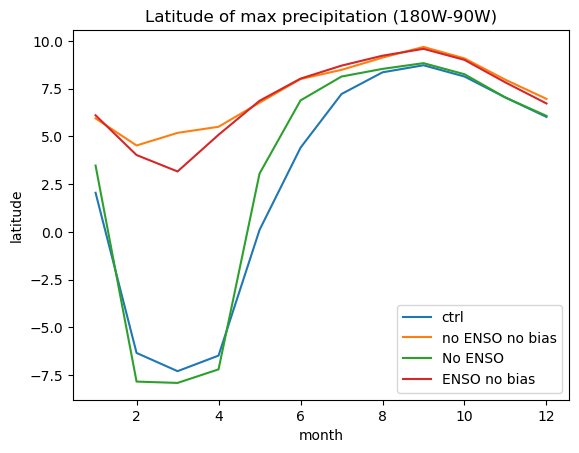

In [82]:
ctrl_pr.sel(longitude = slice(-180, -90)).mean(
    "longitude").idxmax("latitude").groupby("time.month").mean("time").plot(label = "ctrl")
OC_pr.sel(longitude = slice(-180, -90)).mean(
    "longitude").idxmax("latitude").groupby("time.month").mean("time").plot(label = "no ENSO no bias")
MC_pr.sel(longitude = slice(-180, -90)).mean(
    "longitude").idxmax("latitude").groupby("time.month").mean("time").plot(label = "No ENSO")
VC_pr.sel(longitude = slice(-180, -90)).mean(
    "longitude").idxmax("latitude").groupby("time.month").mean("time").plot(label = "ENSO no bias")
plt.legend()
plt.title("Latitude of max precipitation (180W-90W)")

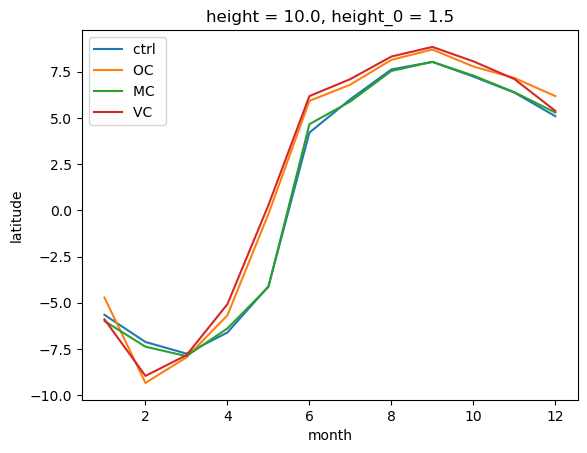

In [91]:
#ctrl_pr.sel(longitude = slice(-180, -90)).mean(
#    "longitude").idxmax("latitude").groupby("time.month").mean("time").plot(label = "ctrl 180-90W")
ctrl_pr.mean("longitude").idxmax("latitude").groupby("time.month").mean("time").plot(label = "ctrl ")
OC_pr.mean("longitude").idxmax("latitude").groupby("time.month").mean("time").plot(label = "OC ")
MC_pr.mean("longitude").idxmax("latitude").groupby("time.month").mean("time").plot(label = "MC ")
VC_pr.mean("longitude").idxmax("latitude").groupby("time.month").mean("time").plot(label = "VC ")
plt.legend()

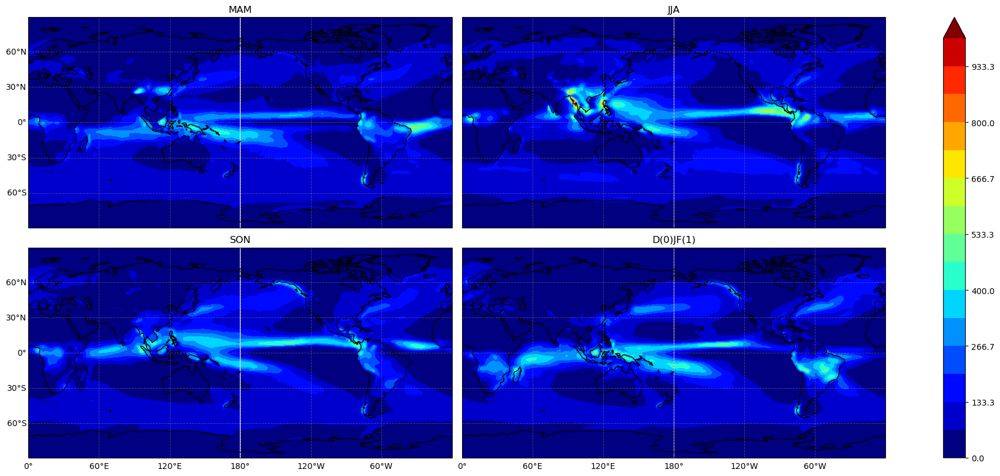

In [46]:
fg = (30*86400*(VC_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))).plot.contourf(
        col = "month", col_wrap = 2,levels = 16,vmin = 0, vmax = 1000, cmap = "jet",
            transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                                  figsize=(20,8))
titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
i=0
for ax,title in zip(fg.axs.flatten(),titles):
    ax.set_title(title )
    ax.coastlines()
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                  linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1]:
        gl.bottom_labels = False
    if i in [1,3]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False
    i = i+1

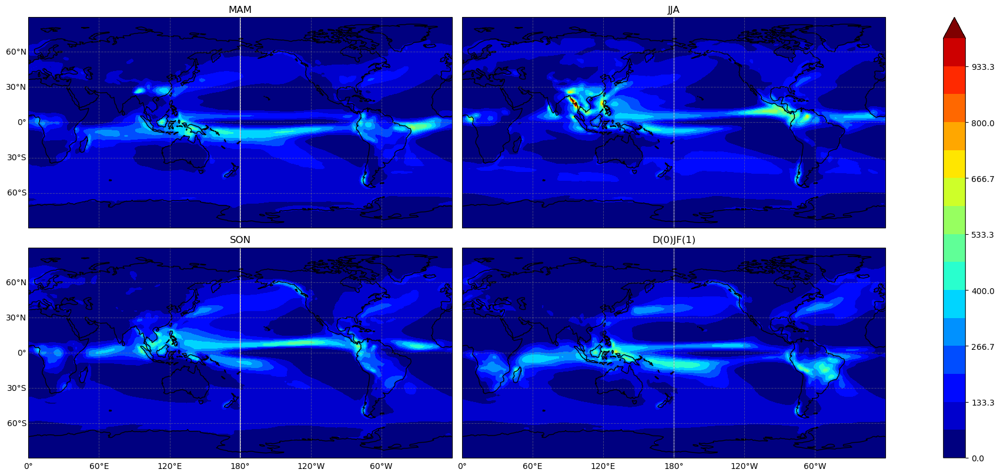

In [47]:
fg = (30*86400*(ctrl_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))).plot.contourf(
        col = "month", col_wrap = 2,levels = 16,vmin = 0, vmax = 1000, cmap = "jet",
            transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                                  figsize=(20,8))
titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
i=0
for ax,title in zip(fg.axs.flatten(),titles):
    ax.set_title(title )
    ax.coastlines()
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                  linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1]:
        gl.bottom_labels = False
    if i in [1,3]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False
    i = i+1

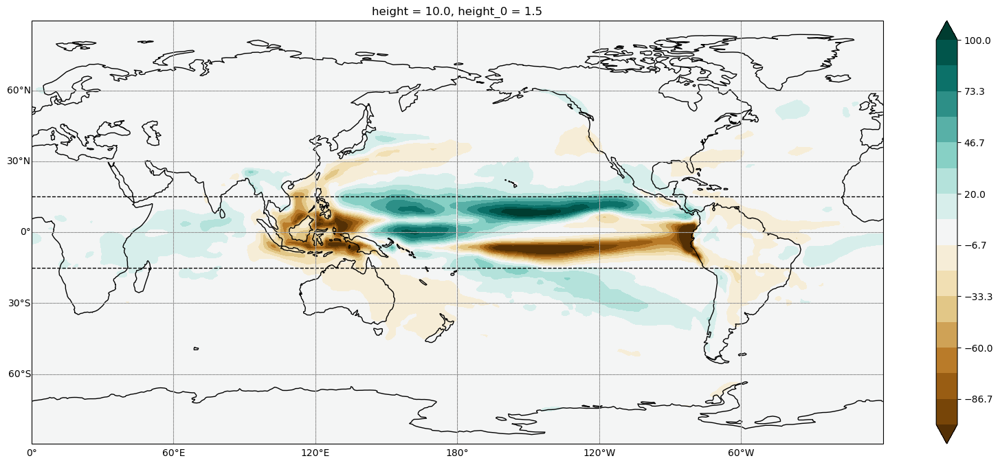

In [49]:
plot_annual(30*86400*VC_pr, 30*86400*ctrl_pr, 100)

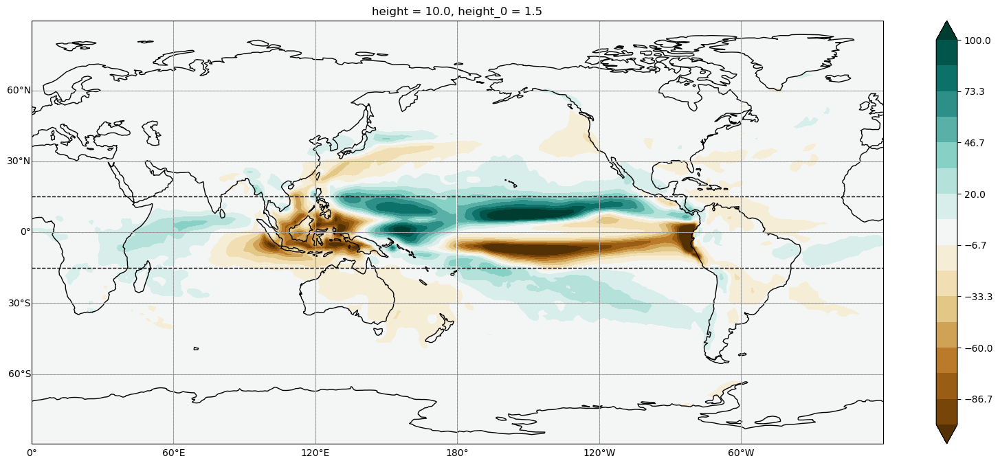

In [50]:
plot_annual(30*86400*OC_pr, 30*86400*ctrl_pr, 100)

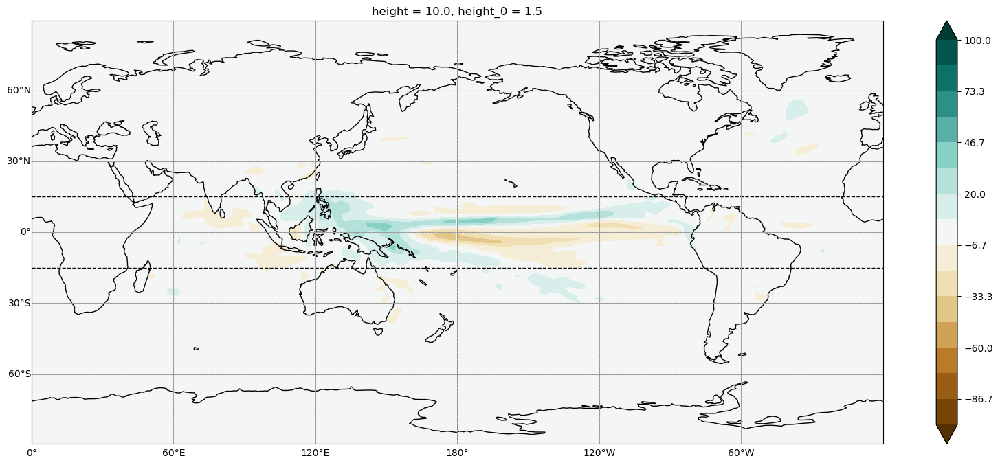

In [51]:
plot_annual(30*86400*MC_pr, 30*86400*ctrl_pr, 100)

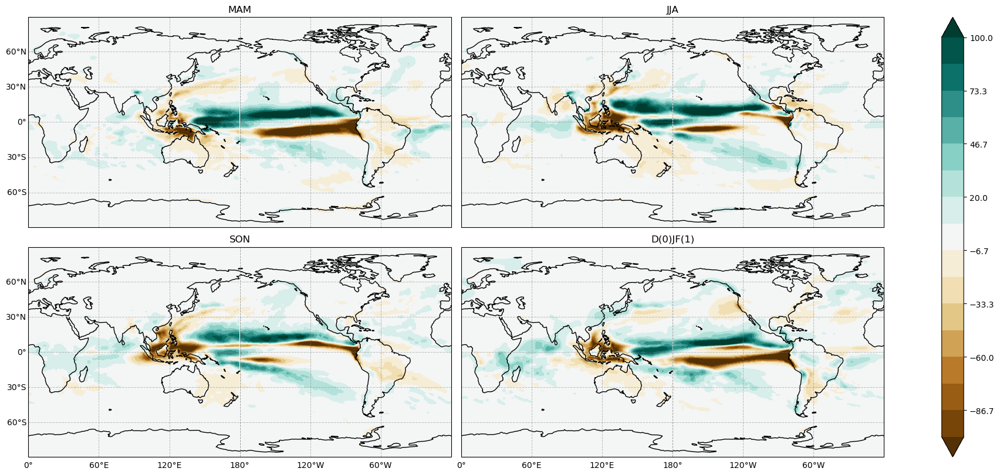

In [32]:
plot_diff(30*86400*VC_pr, 30*86400*ctrl_pr, 100)

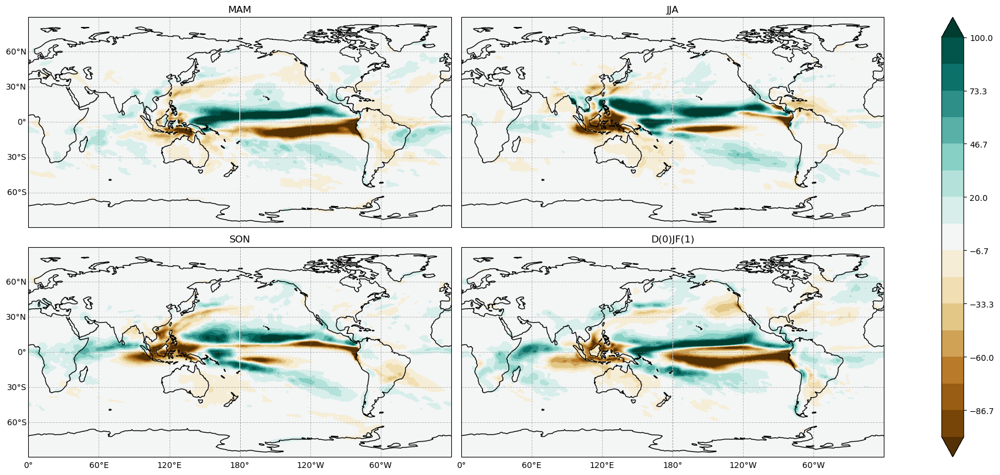

In [33]:
plot_diff(30*86400*OC_pr, 30*86400*ctrl_pr, 100)

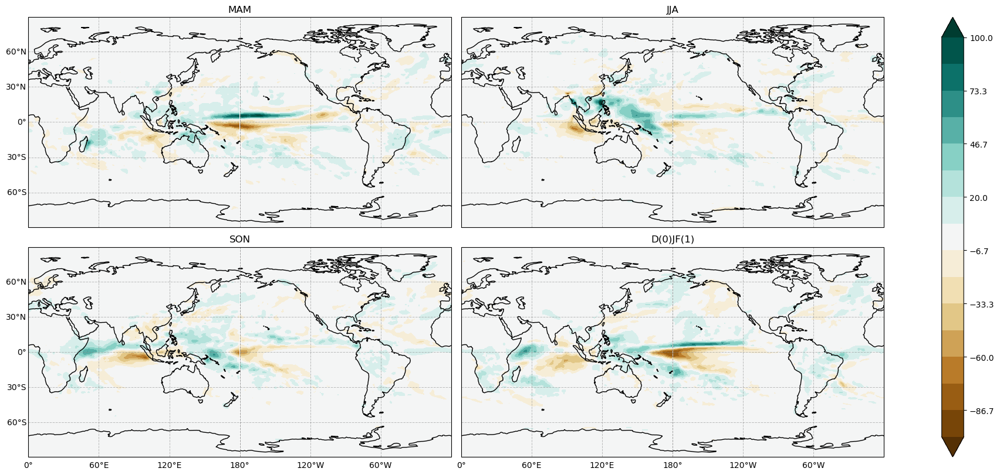

In [35]:
plot_diff(30*86400*OC_pr, 30*86400*VC_pr, 100)

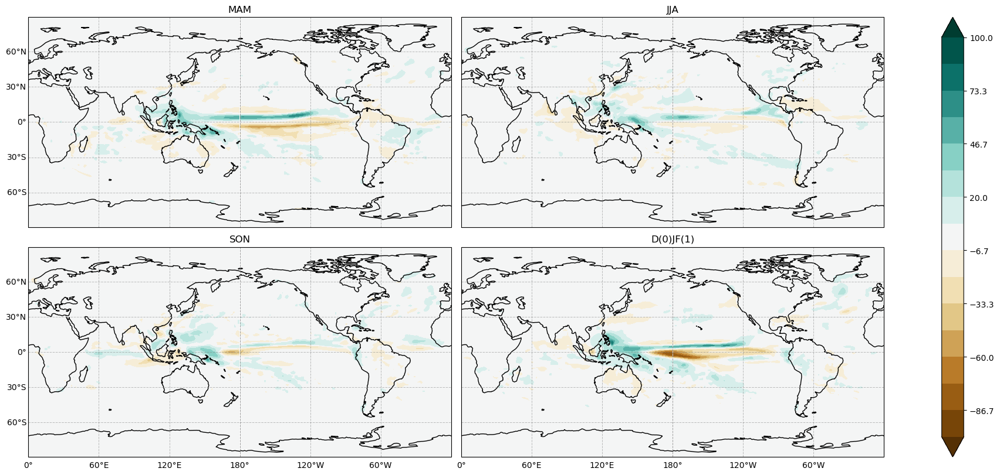

In [34]:
plot_diff(30*86400*MC_pr, 30*86400*ctrl_pr, 100)

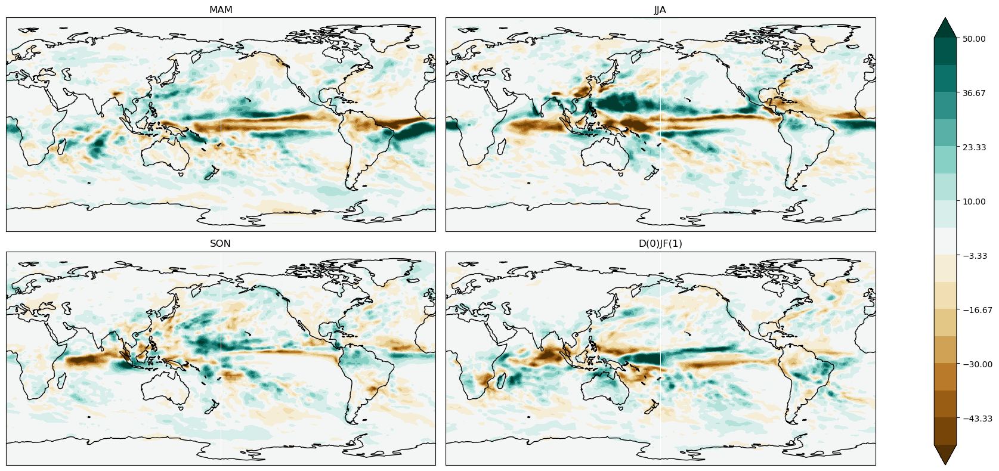

In [51]:
fg = (86400*30*(p_VCpr.groupby('time.month').mean('time') - 
        VC_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time')) - 
     86400*30*(p_ctrlpr.groupby('time.month').mean('time') - 
        ctrl_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))).plot.contourf(
    col = "month", col_wrap = 2,levels = 16,vmin = -50, vmax = 50, cmap = "BrBG", extend = "both",
        transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8))
titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
for ax,title in zip(fg.axs.flatten(),titles):
    ax.set_title(title )
    ax.coastlines()

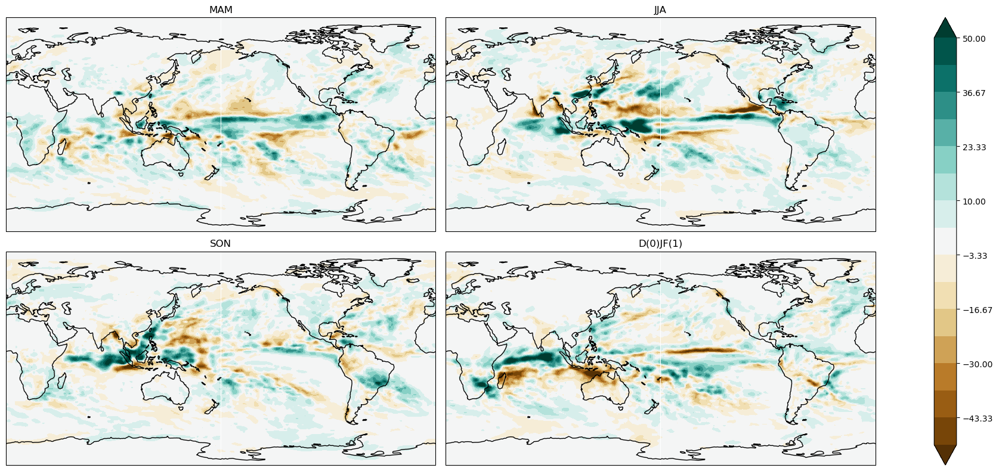

In [52]:
fg = (86400*30*(n_VCpr.groupby('time.month').mean('time') - 
        VC_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time')) - 
     86400*30*(n_ctrlpr.groupby('time.month').mean('time') - 
        ctrl_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))).plot.contourf(
    col = "month", col_wrap = 2,levels = 16,vmin = -50, vmax = 50, cmap = "BrBG", extend = "both",
        transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8))
titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
for ax,title in zip(fg.axs.flatten(),titles):
    ax.set_title(title )
    ax.coastlines()

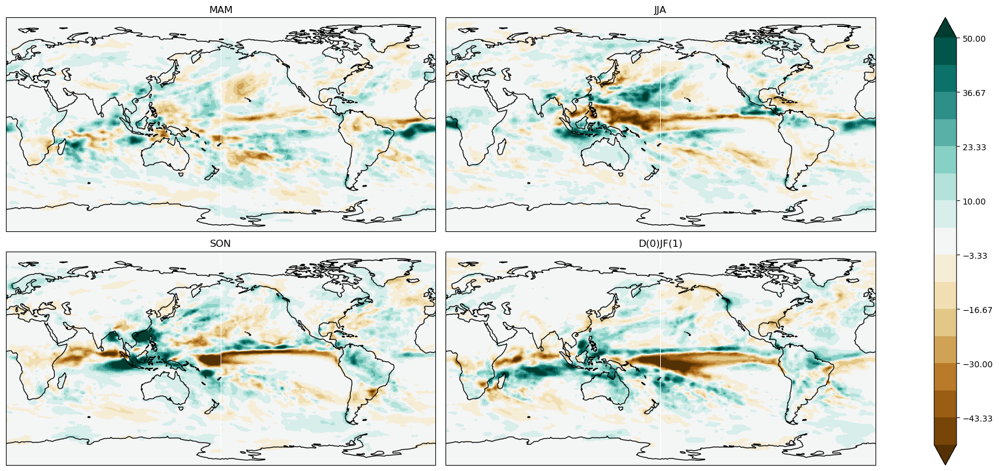

In [53]:
fg = (86400*30*(p_OCpr.groupby('time.month').mean('time') - 
        OC_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time')) - 
     86400*30*(p_ctrlpr.groupby('time.month').mean('time') - 
        ctrl_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))).plot.contourf(
    col = "month", col_wrap = 2,levels = 16,vmin = -50, vmax = 50, cmap = "BrBG", extend = "both",
        transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8))
titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
for ax,title in zip(fg.axs.flatten(),titles):
    ax.set_title(title )
    ax.coastlines()

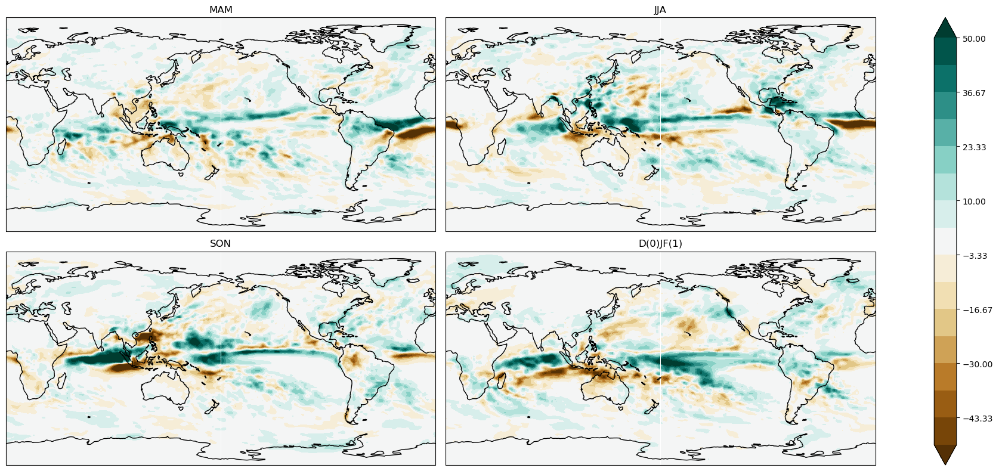

In [54]:
fg = (86400*30*(n_OCpr.groupby('time.month').mean('time') - 
        OC_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time')) - 
     86400*30*(n_ctrlpr.groupby('time.month').mean('time') - 
        ctrl_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))).plot.contourf(
    col = "month", col_wrap = 2,levels = 16,vmin = -50, vmax = 50, cmap = "BrBG", extend = "both",
        transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8))
titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
for ax,title in zip(fg.axs.flatten(),titles):
    ax.set_title(title )
    ax.coastlines()

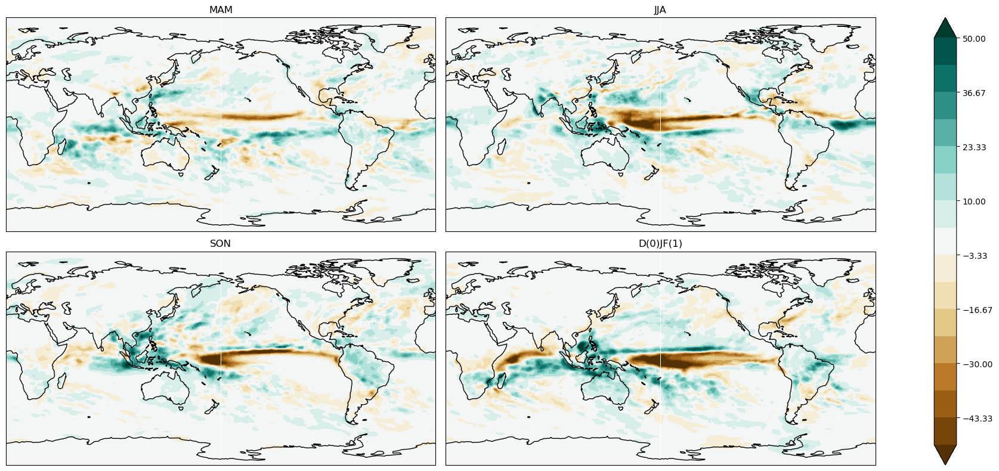

In [55]:
fg = (86400*30*(p_MCpr.groupby('time.month').mean('time') - 
        MC_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time')) - 
     86400*30*(p_ctrlpr.groupby('time.month').mean('time') - 
        ctrl_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))).plot.contourf(
    col = "month", col_wrap = 2,levels = 16,vmin = -50, vmax = 50, cmap = "BrBG", extend = "both",
        transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8))
titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
for ax,title in zip(fg.axs.flatten(),titles):
    ax.set_title(title )
    ax.coastlines()

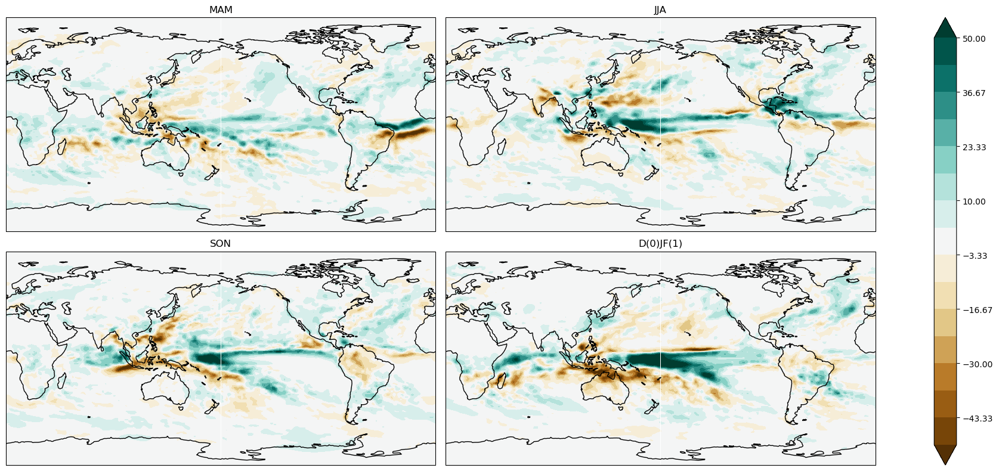

In [56]:
fg = (86400*30*(n_MCpr.groupby('time.month').mean('time') - 
        MC_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time')) - 
     86400*30*(n_ctrlpr.groupby('time.month').mean('time') - 
        ctrl_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))).plot.contourf(
    col = "month", col_wrap = 2,levels = 16,vmin = -50, vmax = 50, cmap = "BrBG", extend = "both",
        transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8))
titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
for ax,title in zip(fg.axs.flatten(),titles):
    ax.set_title(title )
    ax.coastlines()

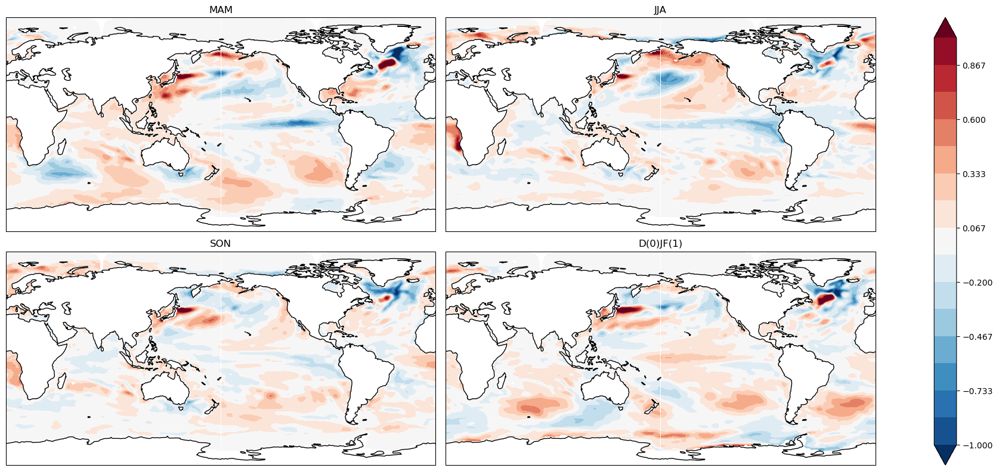

In [55]:
fg = ((p_VC.groupby('time.month').mean('time') - 
        VC.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time')) - 
     (p_ctrl.groupby('time.month').mean('time') - 
        ctrl.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))).plot.contourf(
    col = "month", col_wrap = 2,levels = 16,vmin = -1, vmax = 1, cmap = "RdBu_r", extend = "both",
        transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8))
titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
for ax,title in zip(fg.axs.flatten(),titles):
    ax.set_title(title )
    ax.coastlines()

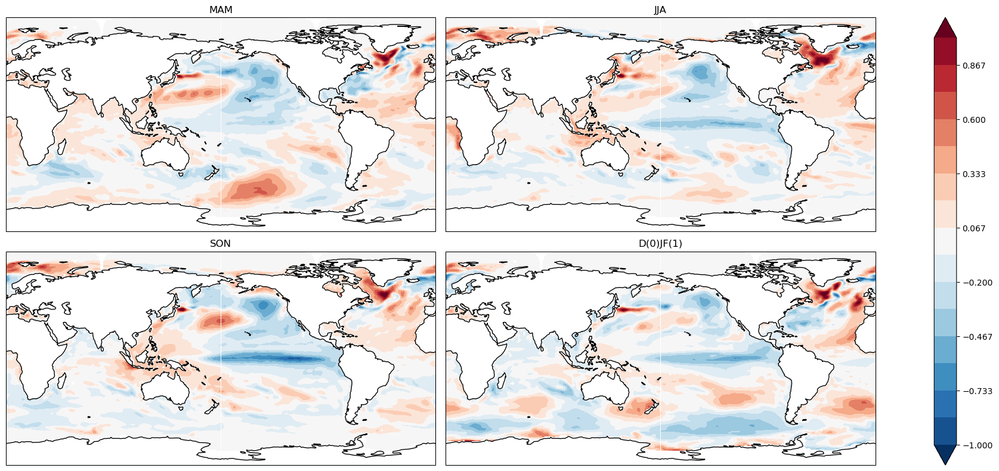

In [56]:
fg = ((p_OC.groupby('time.month').mean('time') - 
        OC.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time')) - 
     (p_ctrl.groupby('time.month').mean('time') - 
        ctrl.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))).plot.contourf(
    col = "month", col_wrap = 2,levels = 16,vmin = -1, vmax = 1, cmap = "RdBu_r", extend = "both",
        transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8))
titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
for ax,title in zip(fg.axs.flatten(),titles):
    ax.set_title(title )
    ax.coastlines()

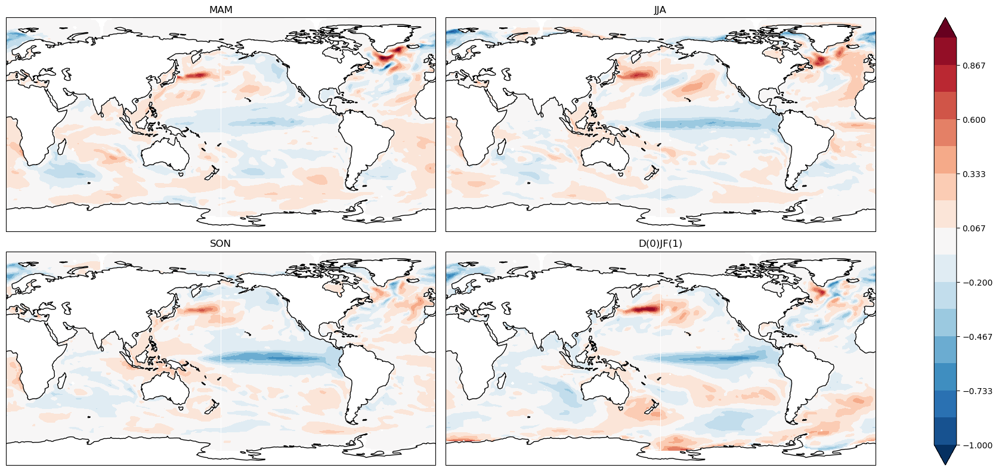

In [57]:
fg = ((p_MC.groupby('time.month').mean('time') - 
        MC.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time')) - 
     (p_ctrl.groupby('time.month').mean('time') - 
        ctrl.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))).plot.contourf(
    col = "month", col_wrap = 2,levels = 16,vmin = -1, vmax = 1, cmap = "RdBu_r", extend = "both",
        transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8))
titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
for ax,title in zip(fg.axs.flatten(),titles):
    ax.set_title(title )
    ax.coastlines()

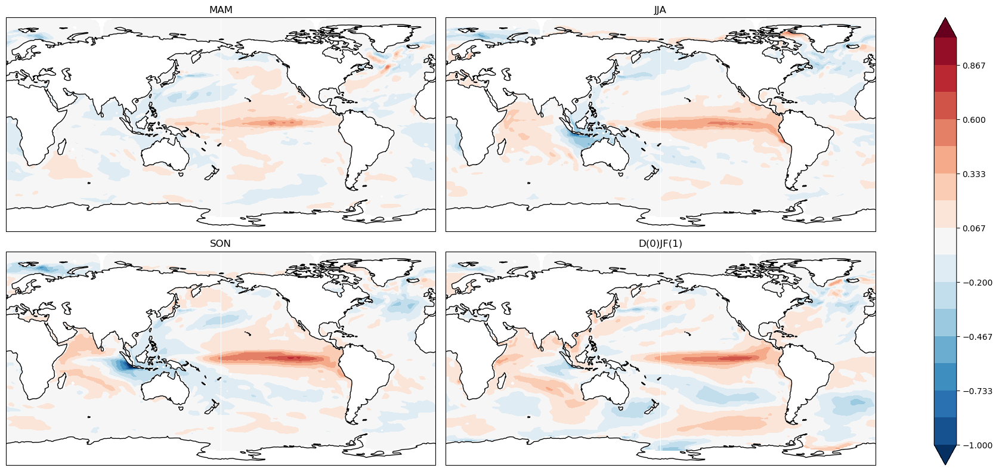

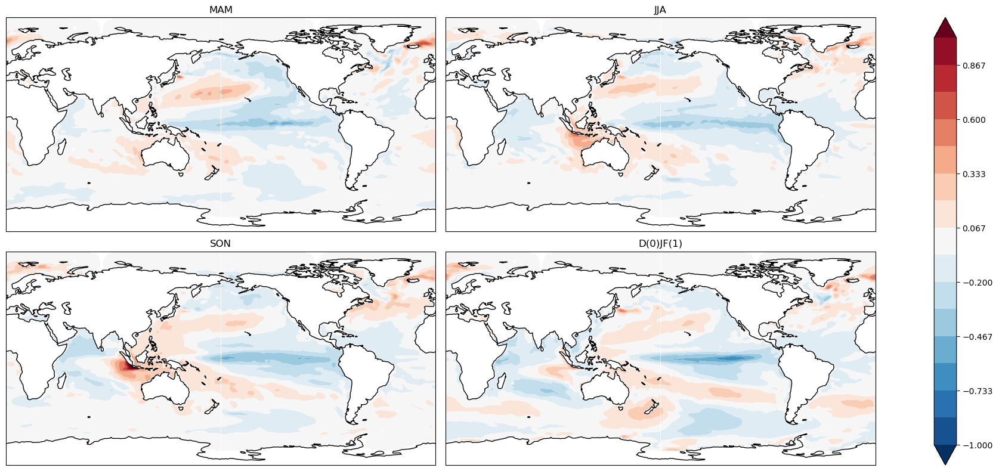

In [52]:
plot_IOD_anoms(p_ctrl, n_ctrl, ctrl, ctrl, 1)

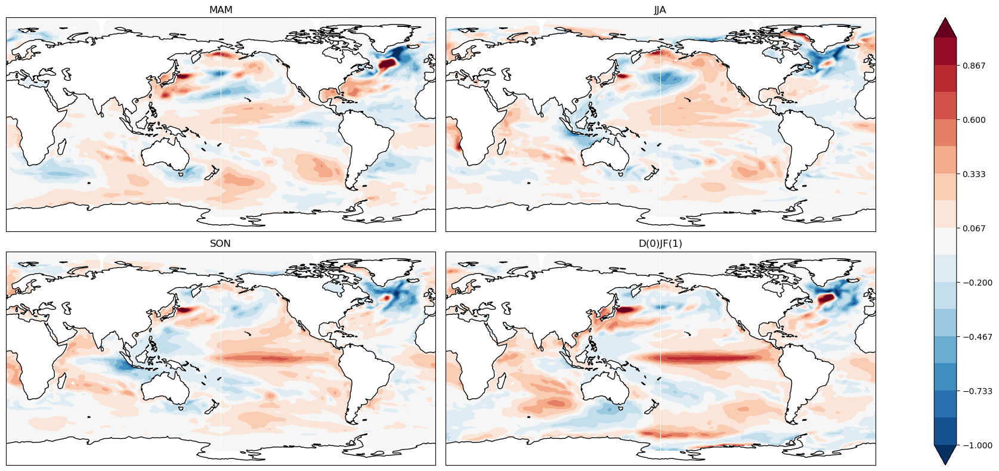

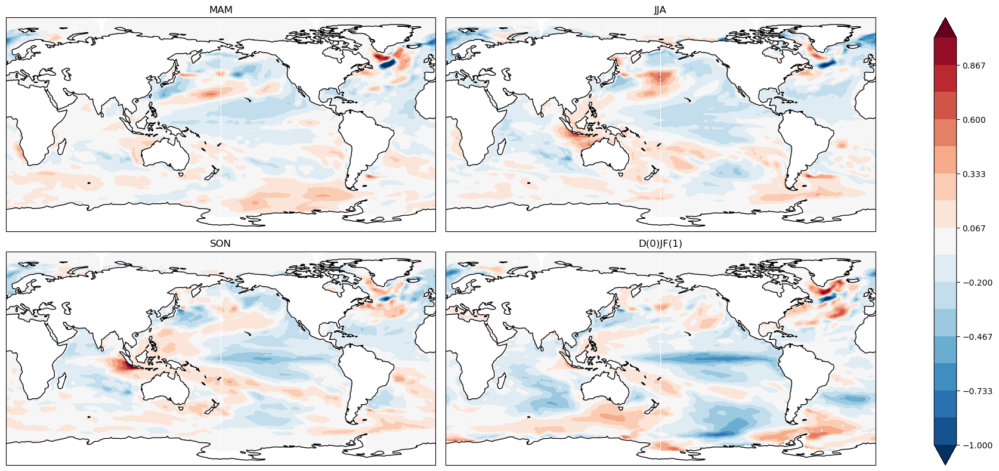

In [51]:
plot_IOD_anoms(p_VC, n_VC, VC, VC, 1)

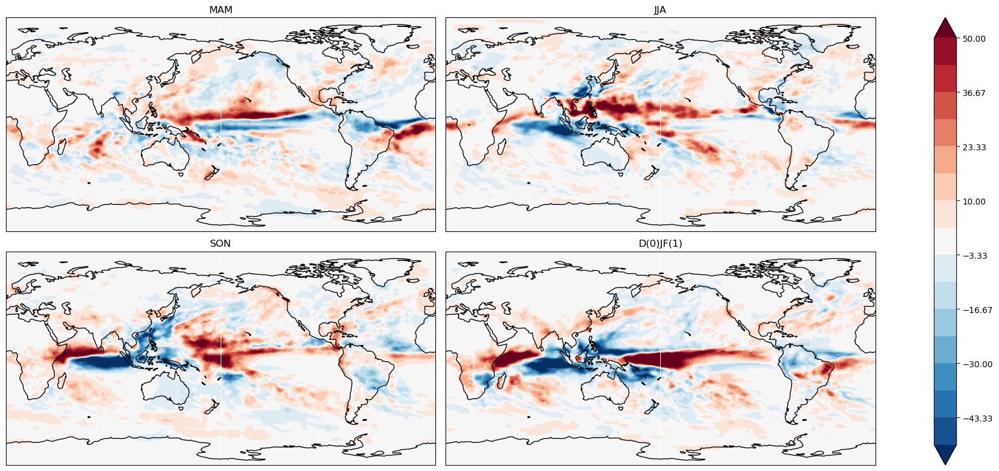

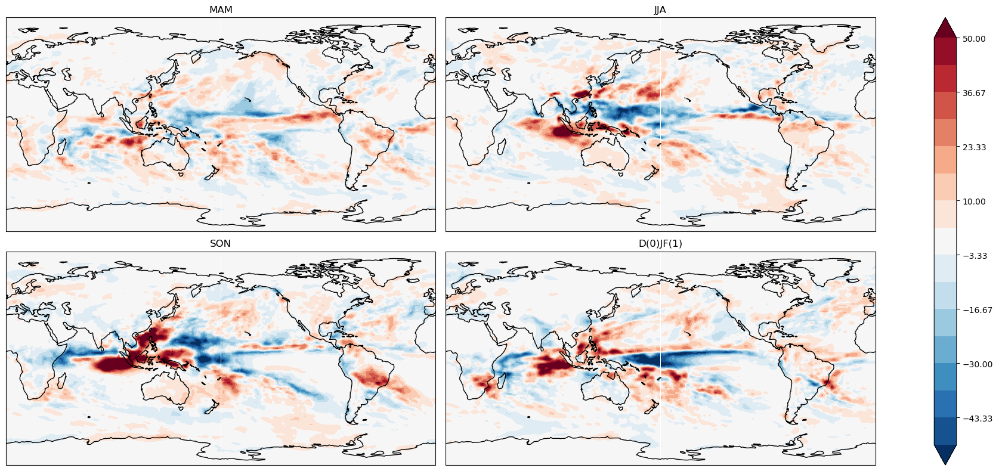

In [62]:
plot_IOD_anoms(p_VCpr, n_VCpr, VC_pr, VC_pr, 50)

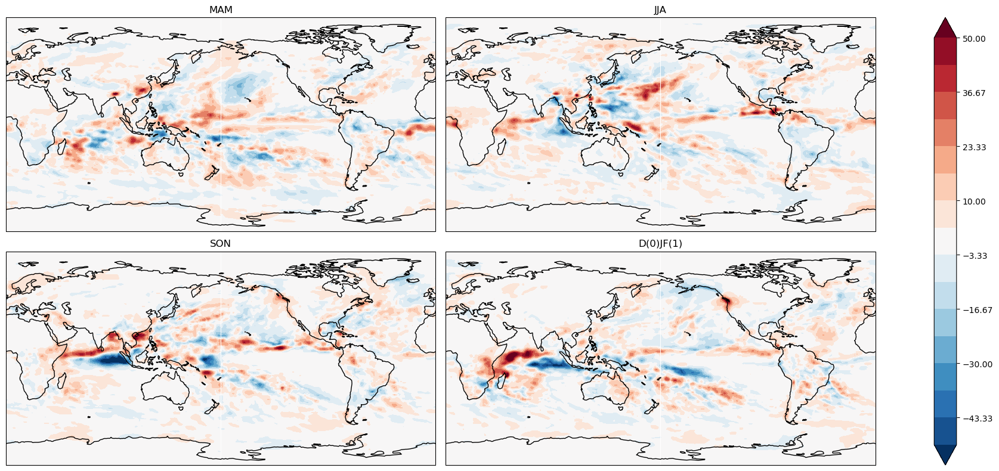

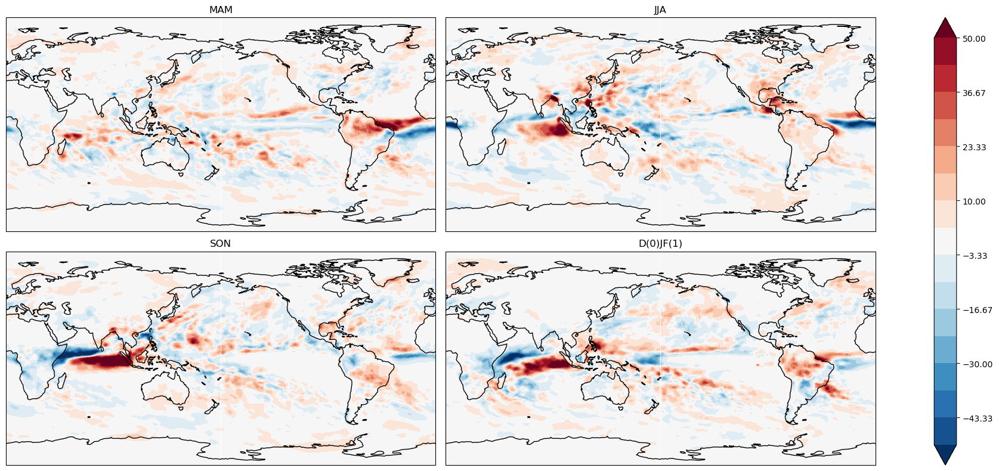

In [63]:
plot_IOD_anoms(p_OCpr, n_OCpr, OC_pr, OC_pr, 50)

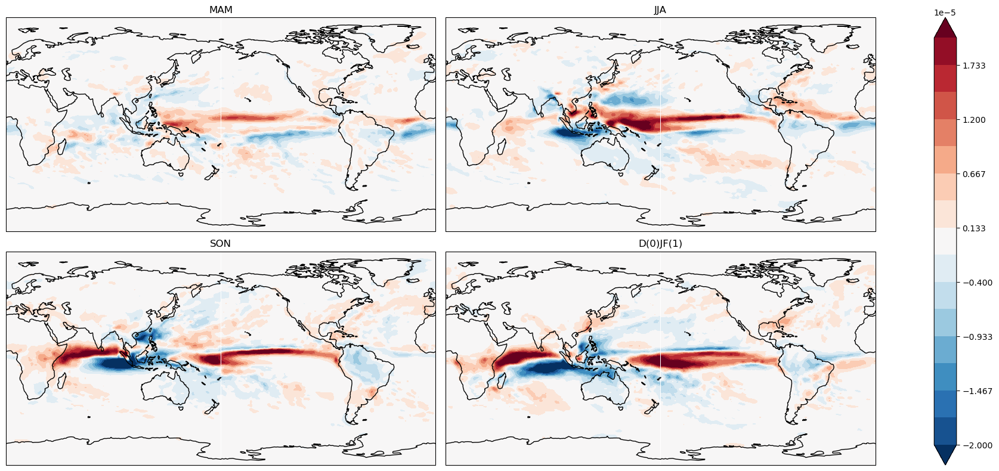

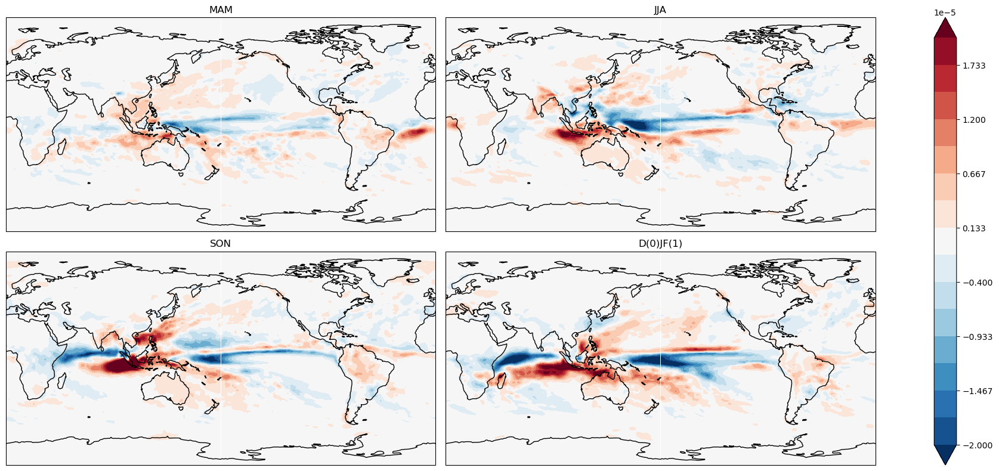

In [58]:
plot_IOD_anoms(p_ctrlpr, n_ctrlpr, ctrl_pr, ctrl_pr, 2e-5)

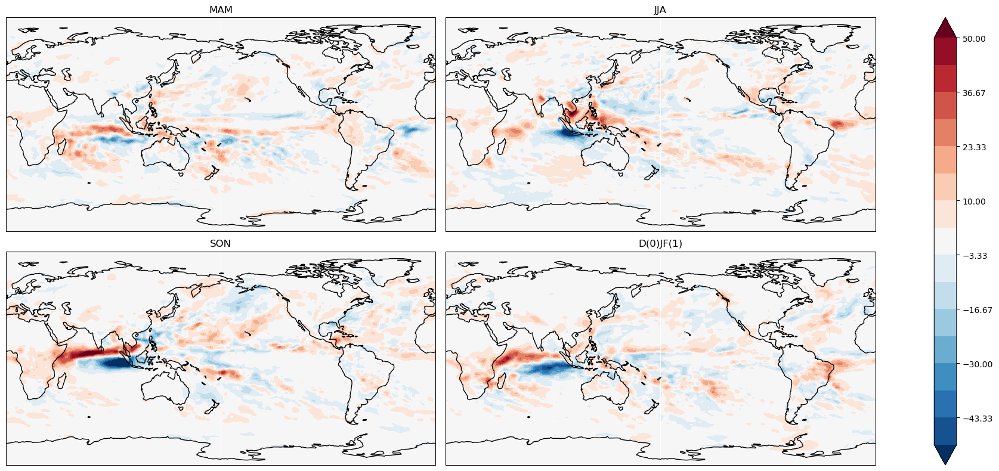

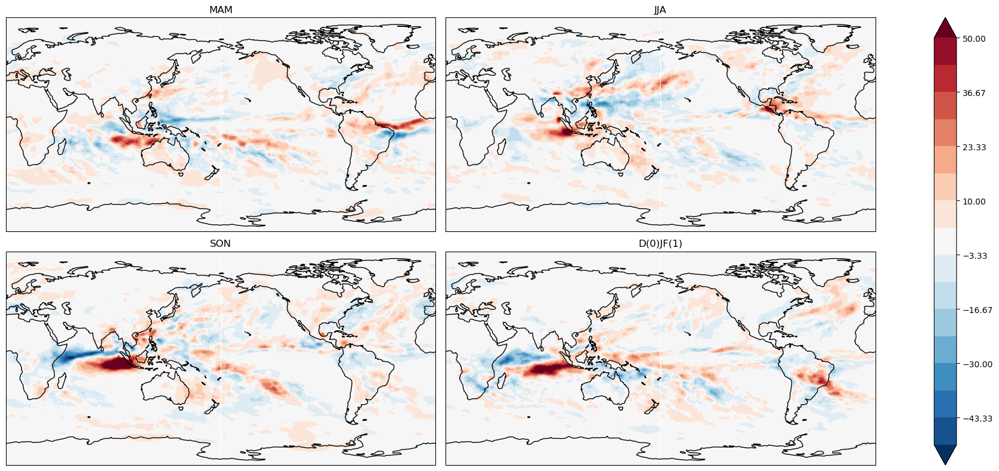

In [65]:
plot_IOD_anoms(p_MCpr, n_MCpr, MC_pr, MC_pr, 50)

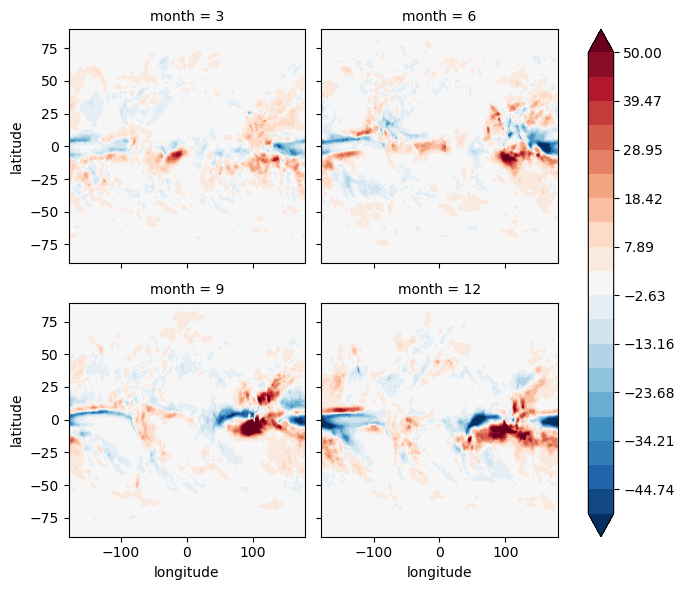

In [236]:
((n.groupby('time.month').mean('time') - 
 ctrl_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))*86400*30).plot.contourf(
    col = "month", col_wrap = 2,vmin = -50, vmax = 50, levels = 20, cmap = "RdBu_r")

In [260]:
p_ctrl, n_ctrl = get_IOD_times(ctrl, ctrl_pr)

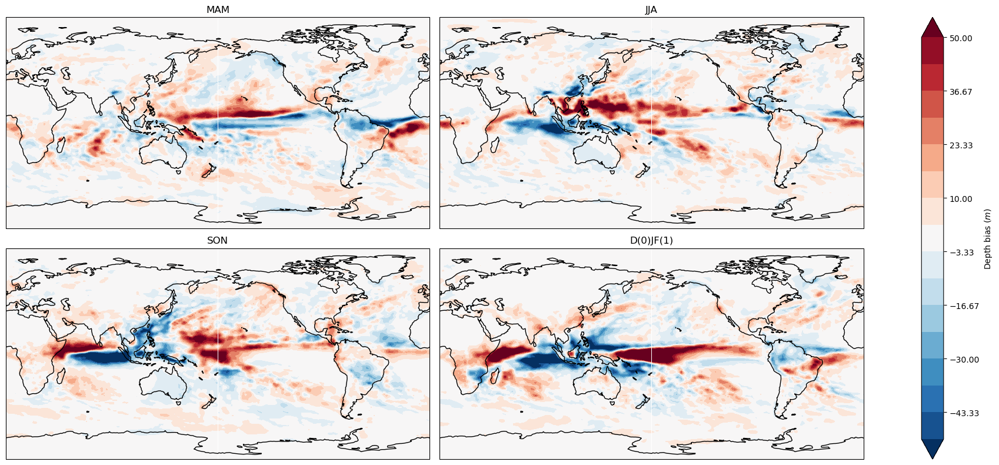

In [60]:
fg = ((p_VCpr.groupby('time.month').mean('time') - 
 VC_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))*86400*30).plot.contourf(
    col = "month", col_wrap = 2,vmin = -50, vmax = 50, levels = 16, cmap = "RdBu_r", extend = "both",
        transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8), cbar_kwargs=dict(label='Depth bias ($m$)'))
titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
for ax,title in zip(fg.axs.flatten(),titles):
    ax.set_title(title )
    ax.coastlines()

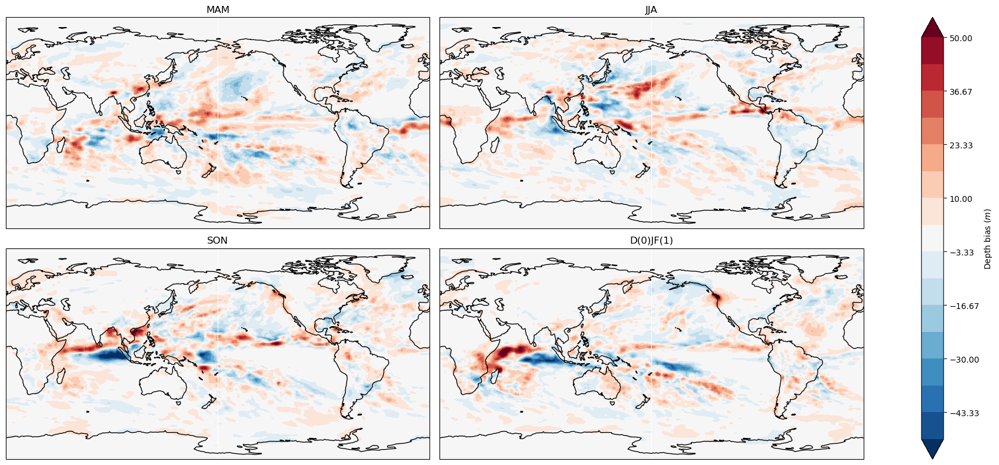

In [62]:
fg = ((p_OCpr.groupby('time.month').mean('time') - 
 OC_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))*86400*30).plot.contourf(
    col = "month", col_wrap = 2,vmin = -50, vmax = 50, levels = 16, cmap = "RdBu_r", extend = "both",
        transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8), cbar_kwargs=dict(label='Depth bias ($m$)'))
titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
for ax,title in zip(fg.axs.flatten(),titles):
    ax.set_title(title )
    ax.coastlines()

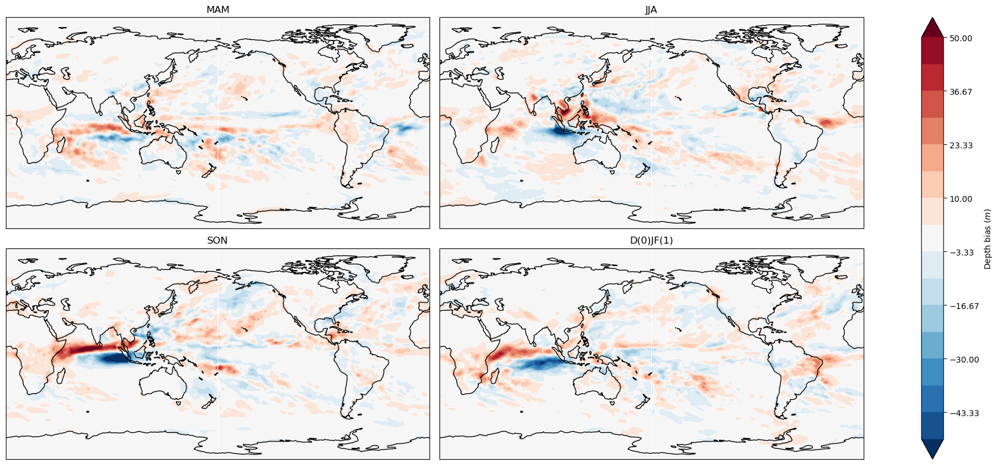

In [63]:
fg = ((p_MCpr.groupby('time.month').mean('time') - 
 MC_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))*86400*30).plot.contourf(
    col = "month", col_wrap = 2,vmin = -50, vmax = 50, levels = 16, cmap = "RdBu_r", extend = "both",
        transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8), cbar_kwargs=dict(label='Depth bias ($m$)'))
titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
for ax,title in zip(fg.axs.flatten(),titles):
    ax.set_title(title )
    ax.coastlines()

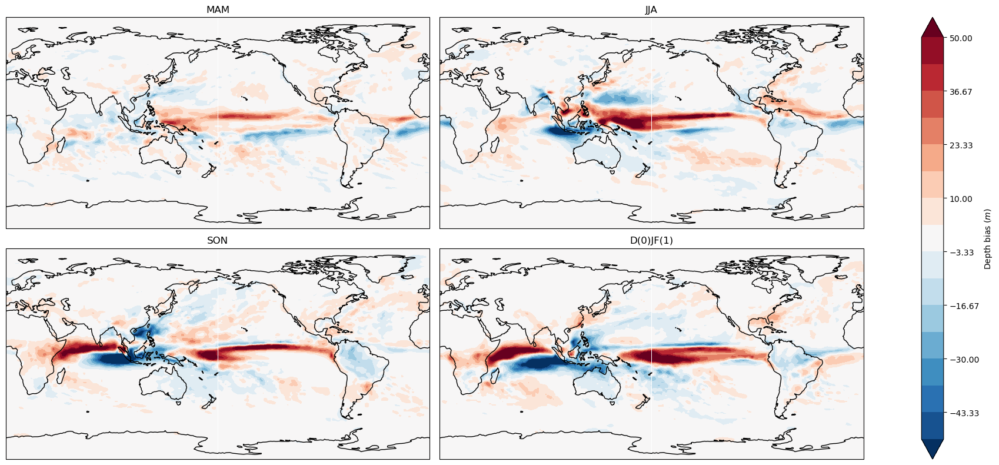

In [61]:
fg = ((p_ctrlpr.groupby('time.month').mean('time') - 
 ctrl_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))*86400*30).plot.contourf(
    col = "month", col_wrap = 2,vmin = -50, vmax = 50, levels = 16, cmap = "RdBu_r", extend = "both",
        transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8), cbar_kwargs=dict(label='Depth bias ($m$)'))
titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
for ax,title in zip(fg.axs.flatten(),titles):
    ax.set_title(title )
    ax.coastlines()

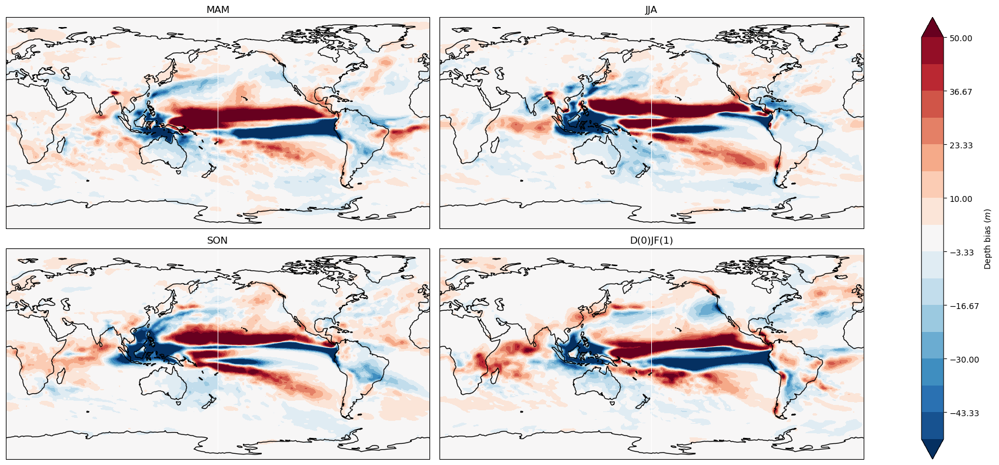

In [266]:
fg = (86400*30*(VC_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time') - ctrl_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))).plot.contourf(
    col = "month", col_wrap = 2,vmin = -50, vmax = 50, levels = 16, cmap = "RdBu_r", extend = "both",
        transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8), cbar_kwargs=dict(label='Depth bias ($m$)'))
titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
for ax,title in zip(fg.axs.flatten(),titles):
    ax.set_title(title )
    ax.coastlines()

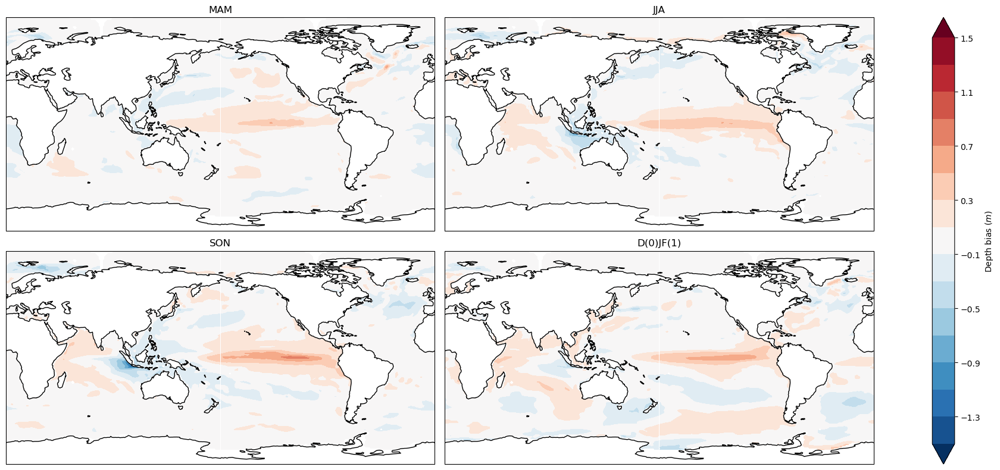

In [256]:
fg = ((p.groupby('time.month').mean('time') - 
 ctrl.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))).plot.contourf(
    col = "month", col_wrap = 2,vmin = -1.5, vmax = 1.5, levels = 16, cmap = "RdBu_r", extend = "both",
        transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8), cbar_kwargs=dict(label='Depth bias ($m$)'))
titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
for ax,title in zip(fg.axs.flatten(),titles):
    ax.set_title(title )
    ax.coastlines()

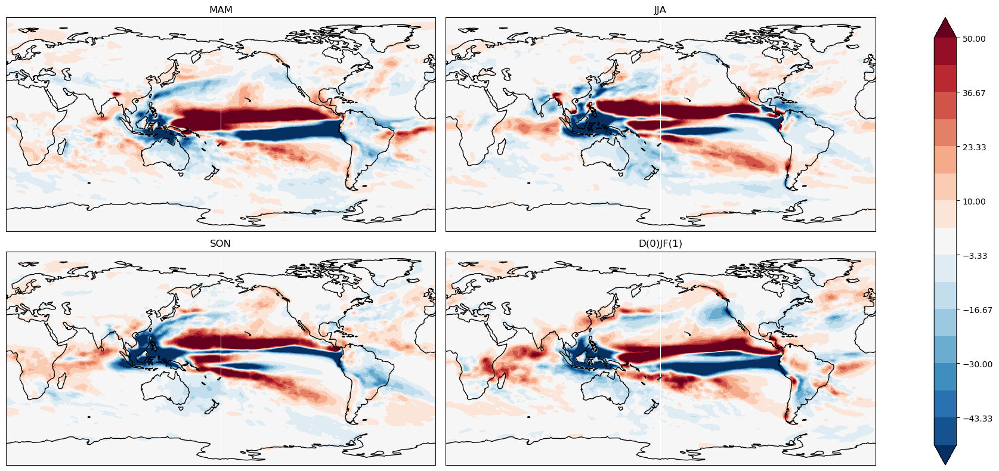

In [50]:
fg = (86400*30*(VC_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time') - ctrl_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))).plot.contourf(
    col = "month", col_wrap = 2,vmin = -50, vmax = 50, levels = 16, cmap = "RdBu_r", extend = "both",
        transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8))
titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
for ax,title in zip(fg.axs.flatten(),titles):
    ax.set_title(title )
    ax.coastlines()

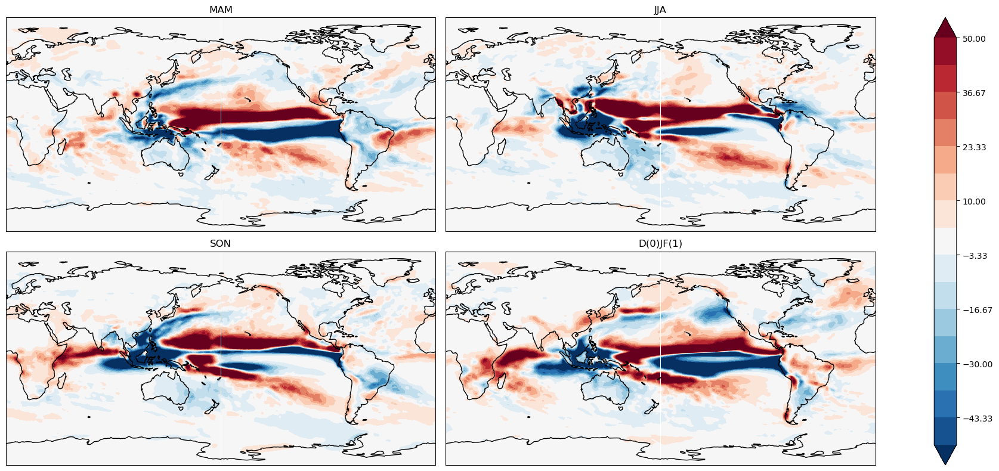

In [51]:
fg = (86400*30*(OC_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time') - ctrl_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))).plot.contourf(
    col = "month", col_wrap = 2,vmin = -50, vmax = 50, levels = 16, cmap = "RdBu_r", extend = "both",
        transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8))
titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
for ax,title in zip(fg.axs.flatten(),titles):
    ax.set_title(title )
    ax.coastlines()

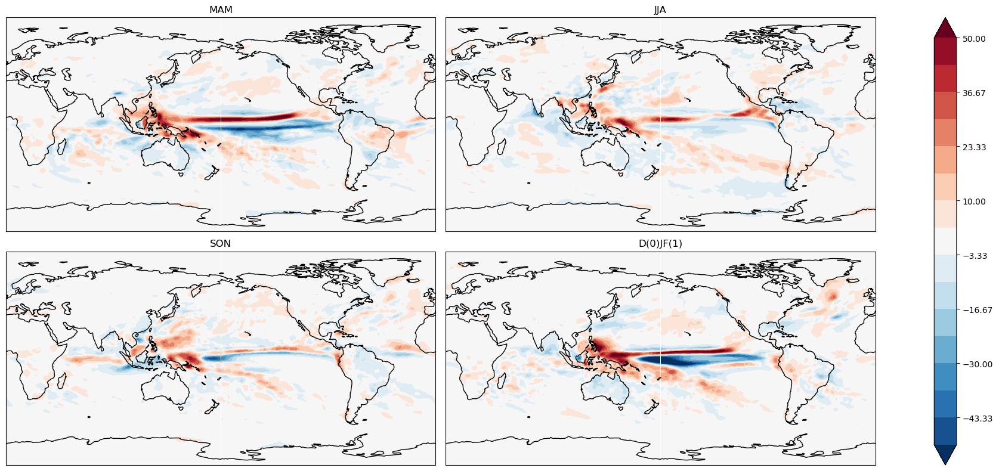

In [52]:
fg = (86400*30*(MC_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time') - ctrl_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time'))).plot.contourf(
    col = "month", col_wrap = 2,vmin = -50, vmax = 50, levels = 16, cmap = "RdBu_r", extend = "both",
        transform=ccrs.PlateCarree(), subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8))
titles =["MAM", "JJA", "SON", "D(0)JF(1)"]
for ax,title in zip(fg.axs.flatten(),titles):
    ax.set_title(title )
    ax.coastlines()

In [68]:
nI, pI = IOD_events(ctrl)
pI.mean(), nI.mean()

(<xarray.DataArray ()>
 array(0.76159644, dtype=float32),
 <xarray.DataArray ()>
 array(-0.6763938, dtype=float32))

In [69]:
nI, pI = IOD_events(MC)
pI.mean(), nI.mean()

(<xarray.DataArray ()>
 array(0.5167716, dtype=float32),
 <xarray.DataArray ()>
 array(-0.496964, dtype=float32))

In [70]:
nI, pI = IOD_events(OC)
pI.mean(), nI.mean()

(<xarray.DataArray ()>
 array(0.4598282, dtype=float32),
 <xarray.DataArray ()>
 array(-0.46427235, dtype=float32))

In [71]:
nI, pI = IOD_events(VC)
pI.mean(), nI.mean()

(<xarray.DataArray ()>
 array(0.6394419, dtype=float32),
 <xarray.DataArray ()>
 array(-0.6479183, dtype=float32))

2023-09-07 10:54:09,457 - distributed.nanny - WARNING - Restarting worker
2023-09-07 10:54:09,590 - distributed.nanny - WARNING - Restarting worker
2023-09-07 10:54:09,661 - distributed.nanny - WARNING - Restarting worker
2023-09-07 10:54:09,667 - distributed.nanny - WARNING - Restarting worker
2023-09-07 10:54:09,801 - distributed.nanny - WARNING - Restarting worker
2023-09-07 10:54:09,909 - distributed.nanny - WARNING - Restarting worker
2023-09-07 10:54:09,912 - distributed.nanny - WARNING - Restarting worker
2023-09-07 10:54:09,975 - distributed.nanny - WARNING - Restarting worker
2023-09-07 10:54:10,030 - distributed.nanny - WARNING - Restarting worker
2023-09-07 10:54:10,239 - distributed.nanny - WARNING - Restarting worker
2023-09-07 10:54:10,243 - distributed.nanny - WARNING - Restarting worker
2023-09-07 10:54:10,246 - distributed.nanny - WARNING - Restarting worker
2023-09-07 10:54:10,297 - distributed.nanny - WARNING - Restarting worker
2023-09-07 10:54:11,252 - distributed.

In [218]:
    #now get the ds_var groupbed by year for each season. 
    # Initialize an empty list to store the subsets
    pos_list = []
    neg_list = []
    # Loop through each year group in ds_var and subset based on the specific years in both nIOD and pIOD
    for year, group in ds_var:
        if year in pIOD:
            pos_subset = group
            pos_list.append(pos_subset)
        elif year in nIOD:
            neg_subset = group
            neg_list.append(neg_subset)
        else:
            pass
    # Combine the subsets into a single DataArray
    subset_ds_pos = xr.concat(pos_subset, dim='time')
    subset_ds_neg = xr.concat(neg_subset, dim='time')

In [196]:
n

<xarray.DataArray (time: 4, latitude: 180, longitude: 360)>
array([[[2.1490553e-06, 2.1454828e-06, 2.1426865e-06, ...,
         2.1598598e-06, 2.1571489e-06, 2.1536241e-06],
        [1.7196908e-06, 1.7126849e-06, 1.7076477e-06, ...,
         1.7537410e-06, 1.7406460e-06, 1.7291622e-06],
        [1.5477344e-06, 1.5536547e-06, 1.5613514e-06, ...,
         1.5418691e-06, 1.5422860e-06, 1.5441101e-06],
        ...,
        [4.0729756e-06, 4.0993964e-06, 4.1290054e-06, ...,
         3.9909041e-06, 4.0229575e-06, 4.0507102e-06],
        [3.7498023e-06, 3.7720440e-06, 3.7976777e-06, ...,
         3.6907170e-06, 3.7121620e-06, 3.7319940e-06],
        [3.4012135e-06, 3.4059692e-06, 3.4137331e-06, ...,
         3.4091208e-06, 3.4032148e-06, 3.4003017e-06]],

       [[1.4871902e-06, 1.4872311e-06, 1.4871097e-06, ...,
         1.4870640e-06, 1.4869192e-06, 1.4869439e-06],
        [1.3526642e-06, 1.3457469e-06, 1.3400650e-06, ...,
         1.3788980e-06, 1.3699059e-06, 1.3611448e-06],
        [1.4193344e-06, 1.4359670e-06, 1.4533116e-06, ...,
         1.3787518e-06, 1.3903268e-06, 1.4036787e-06],
...
        [8.1748885e-06, 8.1855933e-06, 8.2065771e-06, ...,
         8.1785120e-06, 8.1783919e-06, 8.1773151e-06],
        [8.5730526e-06, 8.5596566e-06, 8.5433539e-06, ...,
         8.5554775e-06, 8.5755673e-06, 8.5826696e-06],
        [8.6478676e-06, 8.6709615e-06, 8.6915279e-06, ...,
         8.6105219e-06, 8.6102327e-06, 8.6215650e-06]],

       [[4.3638570e-06, 4.5491638e-06, 4.7169983e-06, ...,
         4.0860991e-06, 4.0728082e-06, 4.1561925e-06],
        [3.5475593e-06, 3.6059187e-06, 3.6690826e-06, ...,
         3.6189672e-06, 3.5250960e-06, 3.4952236e-06],
        [2.3293419e-06, 2.3108864e-06, 2.2957149e-06, ...,
         2.4726198e-06, 2.4014309e-06, 2.3517250e-06],
        ...,
        [1.6433444e-06, 1.6504462e-06, 1.6563498e-06, ...,
         1.6117388e-06, 1.6240430e-06, 1.6347270e-06],
        [1.5210828e-06, 1.5264286e-06, 1.5314663e-06, ...,
         1.5033719e-06, 1.5094497e-06, 1.5153629e-06],
        [1.3594198e-06, 1.3637774e-06, 1.3685426e-06, ...,
         1.3505394e-06, 1.3527068e-06, 1.3555959e-06]]], dtype=float32)
Coordinates:
    height     float64 10.0
    height_0   float64 1.5
  * longitude  (longitude) float64 -179.5 -178.5 -177.5 ... 177.5 178.5 179.5
  * latitude   (latitude) float64 -89.5 -88.5 -87.5 -86.5 ... 87.5 88.5 89.5
  * time       (time) object 1000-03-01 00:00:00 ... 1000-12-01 00:00:00
Attributes:
    regrid_method:  bilinear

In [136]:
test_n, test_p = IOD_events(ctrl)

In [141]:
yrs = test_n.groupby("time.year").mean("time").year

In [149]:
yrs

<xarray.DataArray 'year' (year: 50)>
array([ 959,  961,  970,  975,  981,  984,  985,  986,  988,  990,  994,  996,
        998, 1011, 1016, 1022, 1023, 1025, 1028, 1031, 1034, 1035, 1036, 1040,
       1043, 1048, 1051, 1053, 1056, 1058, 1069, 1070, 1079, 1081, 1090, 1093,
       1097, 1101, 1109, 1110, 1113, 1120, 1121, 1123, 1124, 1133, 1137, 1141,
       1147, 1149])
Coordinates:
  * year     (year) int64 959 961 970 975 981 984 ... 1133 1137 1141 1147 1149

In [154]:
DMI = dmi(ctrl).resample(time='QS-DEC').mean(dim="time").groupby("time.year")#.mean("time")

In [191]:
# Initialize an empty list to store the subsets
subset_list = []

# Loop through each group in DA1 and subset based on the specific years in YRS
for year, group in DMI:
    if year in yrs:
        subset_group = group
        subset_list.append(subset_group)
    else: 
        pass
    # Combine the subsets into a single DataArray
subset_DA1 = xr.concat(subset_list, dim='time')


In [192]:
subset_DA1

<xarray.DataArray (time: 200)>
array([ 0.03675291, -0.06124592, -0.4728088 , -0.18874323,  0.28033403,
       -0.4887326 , -0.5397246 ,  0.0561305 , -0.29060838, -0.10703894,
       -0.9015177 , -0.31112063, -0.46955666, -0.38142338, -0.38730934,
       -0.22600274, -0.07870297, -0.36637327, -0.6916423 , -0.53856105,
        0.03081403, -0.10944802, -0.46618557, -0.34643206, -0.18963657,
       -0.5303807 , -0.47179928, -0.13743198, -0.26220146, -0.13852789,
       -0.58433294, -0.13201584, -0.00805014, -0.6905327 , -0.8289798 ,
       -0.3370355 , -0.10699607, -0.21437366, -0.49353167,  0.0023814 ,
       -0.13427396, -0.00667616, -0.6467862 , -0.52103525,  0.29378116,
        0.05432092, -0.42941168, -0.43740606, -0.22942452, -0.4758203 ,
       -0.7641986 , -0.4986819 ,  0.18121974, -0.48277354, -0.64073074,
       -0.39411688,  0.14266185, -0.93026185, -0.6903656 , -0.15139045,
       -0.20130737, -0.4005053 , -0.3891318 , -0.4874412 ,  0.03187389,
       -0.5410958 , -0.79037184, -0.33196235,  0.2692769 , -0.14154288,
       -0.3668891 , -0.02789724, -0.09095045, -0.39387298, -0.7008321 ,
       -0.45912972,  0.13435602, -0.3475105 , -0.6723091 , -0.26658544,
        0.07804693, -0.36060715, -0.45728338, -0.2003734 , -0.04193652,
       -0.33914495, -0.8081245 , -0.30303982, -0.19326289, -0.54118943,
       -0.9774541 , -0.29974297, -0.10745885, -0.23794176, -0.859164  ,
       -0.00881449,  0.14384428, -0.5096119 , -0.862824  , -0.30307567,
...
       -0.3674384 , -0.7428872 ,  0.08450222, -0.04624636, -0.5056615 ,
       -0.7640152 , -0.03631655, -0.03804126, -0.23514579, -0.50758094,
       -0.2838432 , -0.22196169, -0.0471877 , -0.6197658 ,  0.15971677,
        0.14849277,  0.4029399 , -0.48078224, -0.02996179, -0.13600458,
       -0.25713095, -0.41367567,  0.09480203, -0.13320194, -0.23130576,
       -0.89089257, -0.5225196 , -0.19144261,  0.07739796, -0.5643222 ,
       -0.652494  ,  0.10340787, -0.2630496 , -0.52614546, -0.23096718,
       -0.18310797, -0.19942383, -0.38048998, -0.01989766,  0.13896434,
       -0.46726063, -1.2223636 , -0.6738302 , -0.20480563, -0.03101915,
       -0.59684867, -0.11576939, -0.13653637, -0.23643737, -0.57994604,
       -0.253148  ,  0.01183005, -0.79809   , -1.1807314 , -0.32297003,
        0.16186203, -0.66580755, -0.92462796, -0.25248724, -0.14677711,
        0.26248276, -0.89945   , -0.4800869 ,  0.0482016 , -0.12327072,
       -0.48103464, -0.16216081, -0.13294066, -0.5050867 , -1.1293733 ,
       -0.18113373, -0.00843603, -0.80301   , -1.0793444 , -0.3935256 ,
        0.07422812, -0.4240841 , -0.82062644, -0.48408243, -0.09677831,
        0.0057233 , -0.78259736, -0.32273006, -0.09893468, -0.5755174 ,
       -0.833437  , -0.85029596, -0.12758435, -0.78077906, -0.5783403 ,
       -0.39099333,  0.05192606, -0.05534002, -0.44138798, -0.26259294],
      dtype=float32)
Coordinates:
  * time     (time) object 0959-03-01 00:00:00 ... 1149-12-01 00:00:00

In [188]:
if 959 in yrs.values:
    print("True")

True


In [77]:
neg, pos = IOD_events(ctrl)

In [78]:
SON_var = ctrl_pr.resample(time='QS-DEC').mean(dim="time").groupby('time.season')["SON"]

In [80]:
neg.time

<xarray.DataArray 'time' (time: 50)>
array([cftime.DatetimeGregorian(959, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(961, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(970, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(975, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(981, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(984, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(985, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(986, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(988, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(990, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(994, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(996, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(998, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1011, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1016, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1022, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1023, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1025, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1028, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1031, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1034, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1035, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1036, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1040, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1043, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1048, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1051, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1053, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1056, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1058, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1069, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1070, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1079, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1081, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1090, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1093, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1097, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1101, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1109, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1110, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1113, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1120, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1121, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1123, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1124, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1133, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1137, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1141, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1147, 9, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1149, 9, 1, 0, 0, 0, 0, has_year_zero=False)],
      dtype=object)
Coordinates:
  * time     (time) object 0959-09-01 00:0

In [84]:
ctrl.time

<xarray.DataArray 'time' (time: 2400)>
array([cftime.DatetimeGregorian(951, 1, 16, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(951, 2, 15, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(951, 3, 16, 12, 0, 0, 0, has_year_zero=False),
       ...,
       cftime.DatetimeGregorian(1150, 10, 16, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1150, 11, 16, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1150, 12, 16, 12, 0, 0, 0, has_year_zero=False)],
      dtype=object)
Coordinates:
  * time     (time) object 0951-01-16 12:00:00 ... 1150-12-16 12:00:00

In [101]:
#ctrl_pr.time
test = ctrl_pr

In [99]:
test.coords['time'] = ctrl.time

In [103]:
datetimeindex = test.indexes['time'].

AttributeError: 'CFTimeIndex' object has no attribute 'to_cfindex'

In [42]:
VC_psl.groupby('time.season').mean('time')

<xarray.DataArray (season: 4, latitude: 180, longitude: 360)>
array([[[ 68695.516,  68707.68 ,  68719.73 , ...,  68658.26 ,
          68670.76 ,  68683.195],
        [ 68406.2  ,  68395.13 ,  68384.14 , ...,  68439.43 ,
          68428.38 ,  68417.305],
        [ 69347.586,  69349.91 ,  69352.76 , ...,  69346.164,
          69346.02 ,  69346.3  ],
        ...,
        [102146.84 , 102146.44 , 102146.016, ..., 102147.766,
         102147.52 , 102147.2  ],
        [102087.61 , 102087.39 , 102087.2  , ..., 102088.03 ,
         102087.93 , 102087.76 ],
        [102028.67 , 102028.63 , 102028.55 , ..., 102028.805,
         102028.75 , 102028.72 ]],

       [[ 67253.64 ,  67266.53 ,  67279.37 , ...,  67214.32 ,
          67227.52 ,  67240.625],
        [ 66893.805,  66881.24 ,  66868.82 , ...,  66931.86 ,
          66919.18 ,  66906.52 ],
        [ 67805.18 ,  67805.125,  67805.76 , ...,  67811.86 ,
          67808.84 ,  67806.46 ],
...
        [102300.89 , 102301.49 , 102302.15 , ..., 102298.75 ,
         102299.53 , 102300.23 ],
        [102266.02 , 102266.43 , 102266.79 , ..., 102264.69 ,
         102265.125, 102265.57 ],
        [102232.586, 102232.75 , 102232.89 , ..., 102232.16 ,
         102232.34 , 102232.48 ]],

       [[ 67497.43 ,  67509.94 ,  67522.375, ...,  67459.195,
          67471.99 ,  67484.77 ],
        [ 67164.06 ,  67152.14 ,  67140.34 , ...,  67200.02 ,
          67188.04 ,  67176.07 ],
        [ 68080.016,  68080.99 ,  68082.62 , ...,  68083.2  ,
          68081.42 ,  68080.195],
        ...,
        [101977.46 , 101977.93 , 101978.43 , ..., 101975.766,
         101976.35 , 101976.92 ],
        [101949.   , 101949.34 , 101949.664, ..., 101947.88 ,
         101948.266, 101948.63 ],
        [101920.61 , 101920.71 , 101920.836, ..., 101920.18 ,
         101920.336, 101920.43 ]]], dtype=float32)
Coordinates:
    height     float64 10.0
    height_0   float64 1.5
  * longitude  (longitude) float64 -179.5 -178.5 -177.5 ... 177.5 178.5 179.5
  * latitude   (latitude) float64 -89.5 -88.5 -87.5 -86.5 ... 87.5 88.5 89.5
  * season     (season) object 'DJF' 'JJA' 'MAM' 'SON'
Attributes:
    regrid_method:  bilinear

In [18]:
VC_psl.attrs

{'regrid_method': 'bilinear'}

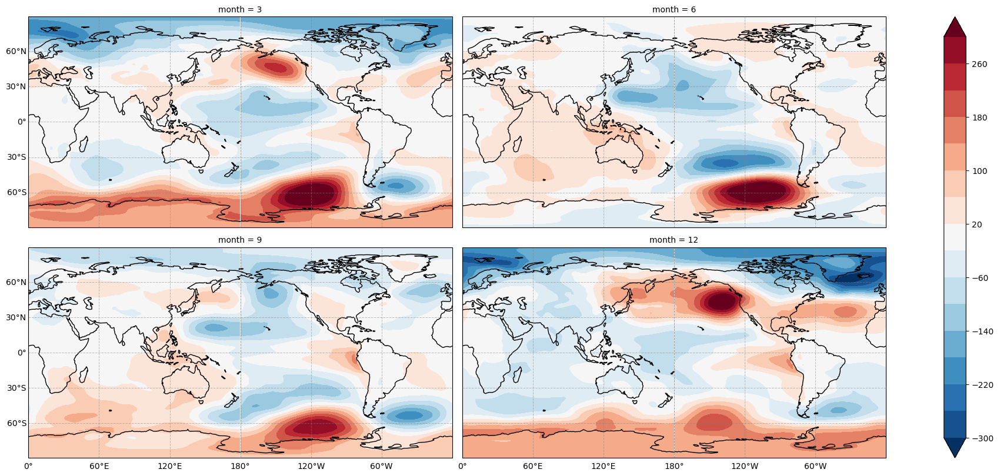

In [44]:
fg = (VC_psl.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time') -  
      ctrl_psl.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time')).plot.contourf(
    col='month', col_wrap = 2,  transform=ccrs.PlateCarree(),
                             subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8),vmin = -300, vmax = 300, levels = 16, cmap = "RdBu_r", extend = "both")
for i, ax in enumerate(fg.axs.flat):
    ax.coastlines()
    #ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1]:
        gl.bottom_labels = False
    if i in [1,3]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False       

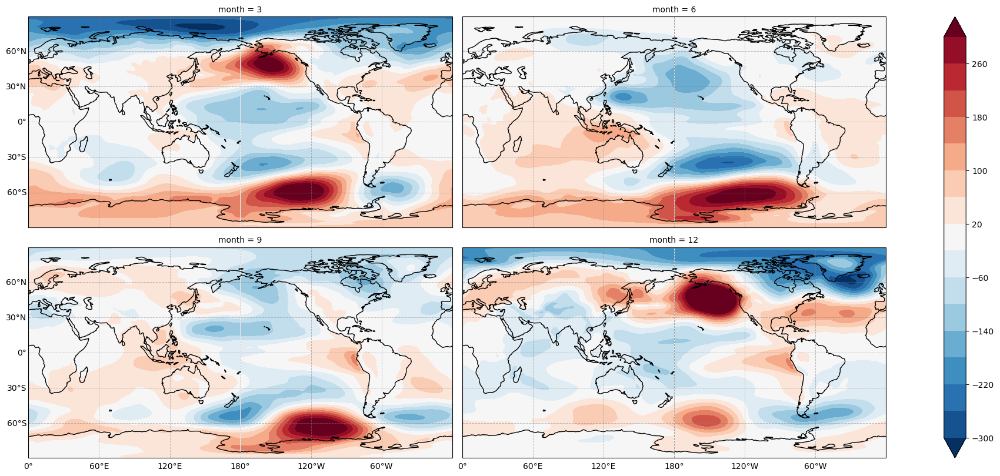

In [13]:
fg = (OC_psl.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time') -  
      ctrl_psl.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time')).plot.contourf(
    col='month', col_wrap = 2,  transform=ccrs.PlateCarree(),
                             subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8),vmin = -300, vmax = 300, levels = 16, cmap = "RdBu_r", extend = "both")
for i, ax in enumerate(fg.axs.flat):
    ax.coastlines()
    #ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1]:
        gl.bottom_labels = False
    if i in [1,3]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False       

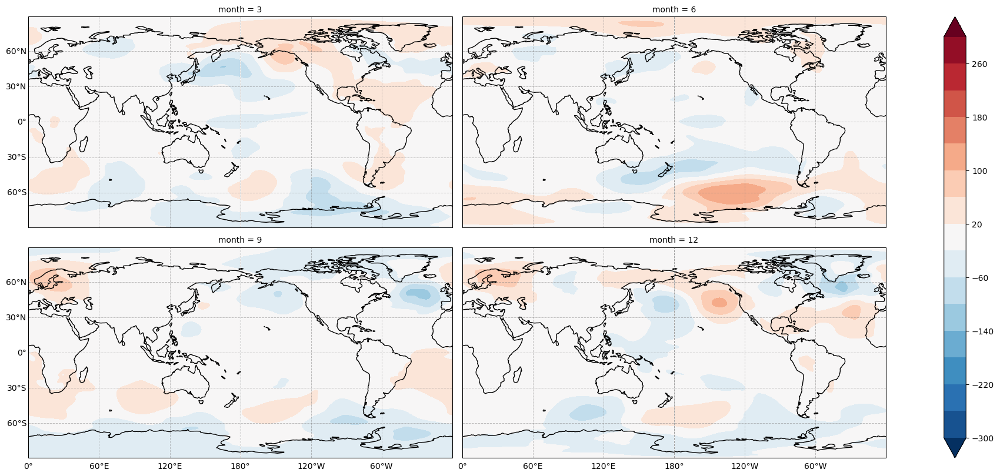

In [14]:
fg = (MC_psl.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time') -  
      ctrl_psl.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time')).plot.contourf(
    col='month', col_wrap = 2,  transform=ccrs.PlateCarree(),
                             subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8),vmin = -300, vmax = 300, levels = 16, cmap = "RdBu_r", extend = "both")
for i, ax in enumerate(fg.axs.flat):
    ax.coastlines()
    #ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1]:
        gl.bottom_labels = False
    if i in [1,3]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False       

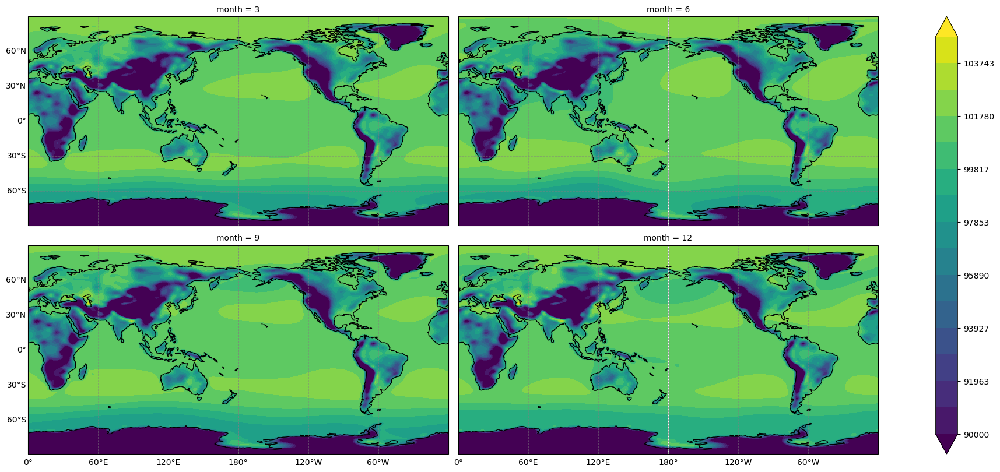

In [16]:
fg = (ctrl_psl.resample(time='QS-DEC').mean(dim="time").groupby('time.month').mean('time')).plot.contourf(
    col='month', col_wrap = 2,  transform=ccrs.PlateCarree(),
                             subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8),vmin = 90000, levels = 16,  extend = "both")
for i, ax in enumerate(fg.axs.flat):
    ax.coastlines()
    #ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1]:
        gl.bottom_labels = False
    if i in [1,3]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False       

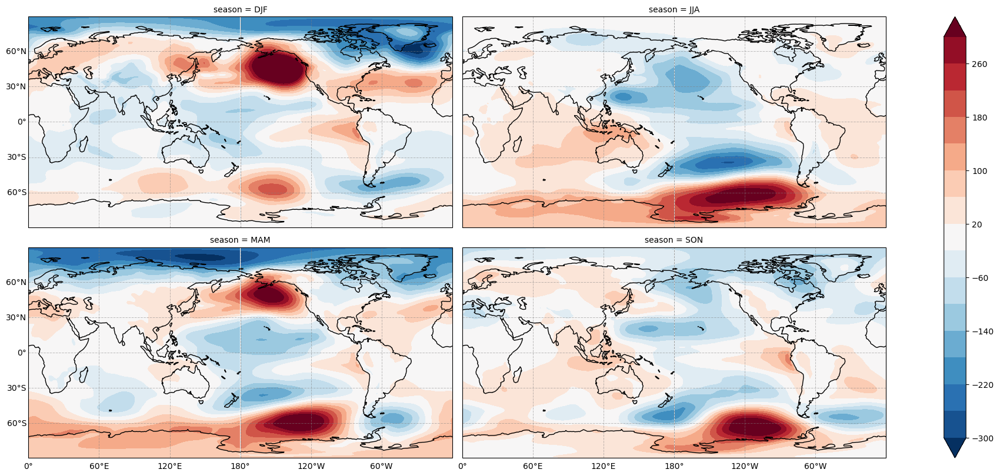

In [36]:
fg = (OC_psl.groupby('time.season').mean('time') -  ctrl_psl.groupby('time.season').mean('time')).plot.contourf(
    col='season', col_wrap = 2,  transform=ccrs.PlateCarree(),
                             subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8),vmin = -300, vmax = 300, levels = 16, cmap = "RdBu_r", extend = "both")
for i, ax in enumerate(fg.axs.flat):
    ax.coastlines()
    #ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1]:
        gl.bottom_labels = False
    if i in [1,3]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False       

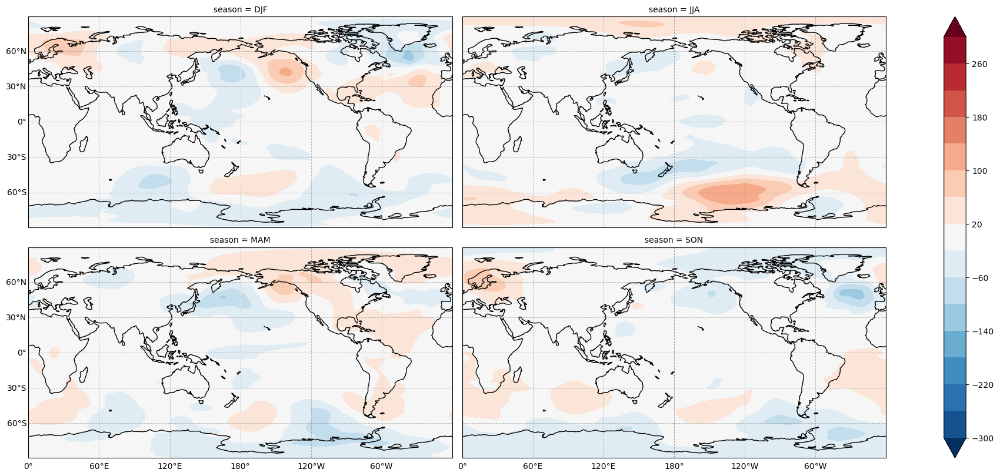

In [37]:
fg = (MC_psl.groupby('time.season').mean('time') -  ctrl_psl.groupby('time.season').mean('time')).plot.contourf(
    col='season', col_wrap = 2,  transform=ccrs.PlateCarree(),
                             subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8),vmin = -300, vmax = 300, levels = 16, cmap = "RdBu_r", extend = "both")
for i, ax in enumerate(fg.axs.flat):
    ax.coastlines()
    #ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1]:
        gl.bottom_labels = False
    if i in [1,3]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False       

In [62]:
ds = xr.open_dataset("/g/data/e14/sm2435/Pacemaker/sst_restore_mask_tropical_Pacific_Ocean_15S-15N_5degdampimg.nc", decode_times=False)

In [65]:
ds = ds.where(ds>0)

Text(0.5, 1.0, 'Restoring mask')

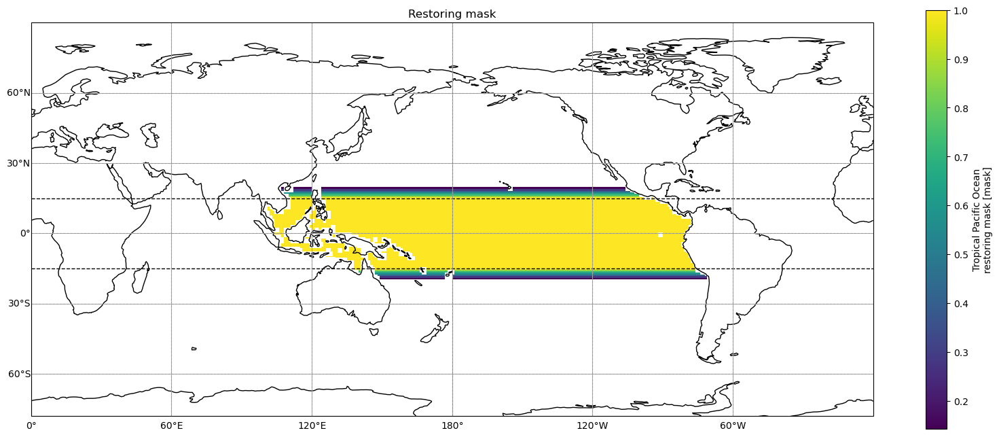

In [70]:
plt.figure(figsize = (20,8))
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
ds.restore_mask[0,0].plot(transform=ccrs.PlateCarree())
ax.coastlines(color = 'k')
ax.axhline(y=-15, color='black', linestyle='--', linewidth=1)  # 15S
ax.axhline(y=15, color='black', linestyle='--', linewidth=1)
ax.gridlines()
#ax.set_facecolor('grey')
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')
gl.top_labels = False
gl.right_labels = False
ax.set_title("Restoring mask")

In [95]:
def NINO34(DS):
    return ssta(DS).sel(latitude=slice(-5, 5),longitude=slice(-170, -120)).mean(['latitude', 'longitude'])

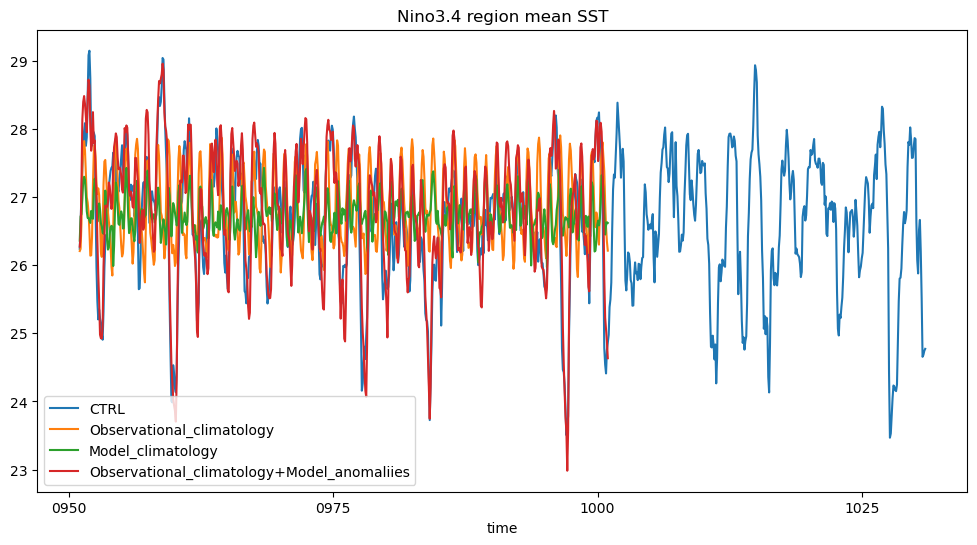

In [94]:
plt.figure(figsize = (12,6))
NINO34(ctrl.sel(time = slice("0951-01-01", "1030-12-31"))).plot(label = "CTRL")
NINO34(OC.sel(time = slice("0951-01-01", "1000-12-31"))).plot(label = "Observational_climatology")
NINO34(MC.sel(time = slice("0951-01-01", "1000-12-31"))).plot(label = "Model_climatology")
NINO34(VC.sel(time = slice("0951-01-01", "1000-12-31"))).plot(label = 'Observational_climatology+Model_anomaliies')
plt.title("Nino3.4 region mean SST")
plt.legend(loc = 'lower left')

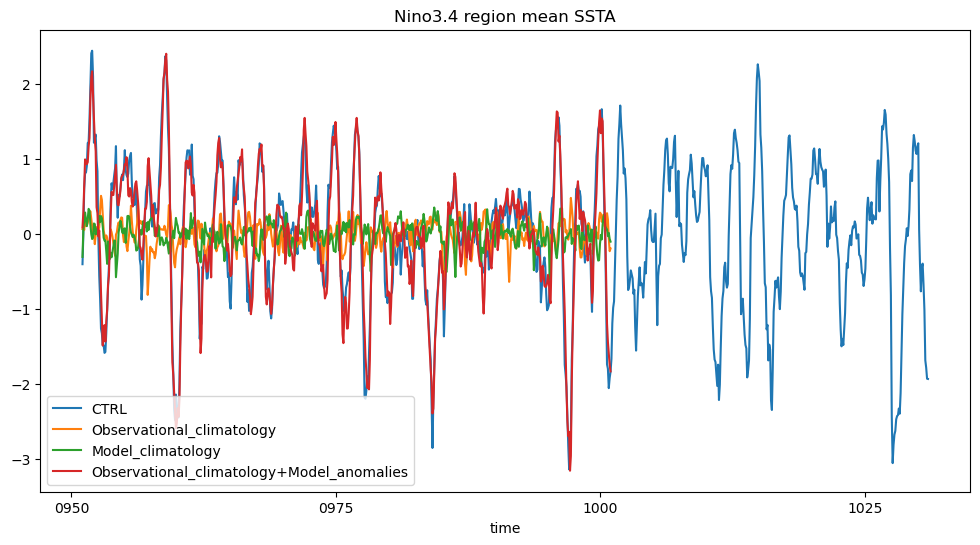

In [96]:
plt.figure(figsize = (12,6))
NINO34(ctrl.sel(time = slice("0951-01-01", "1030-12-31"))).plot(label = "CTRL")
NINO34(OC.sel(time = slice("0951-01-01", "1000-12-31"))).plot(label = "Observational_climatology")
NINO34(MC.sel(time = slice("0951-01-01", "1000-12-31"))).plot(label = "Model_climatology")
NINO34(VC.sel(time = slice("0951-01-01", "1000-12-31"))).plot(label = 'Observational_climatology+Model_anomalies')
plt.title("Nino3.4 region mean SSTA")
plt.legend(loc = 'lower left')

In [86]:
from scipy.stats import skew

In [90]:
skew(NINO34(ctrl))

-0.3670121325648246

In [98]:
skew(NINO34(ctrl.sel(time = slice("0951-01-01", "1000-12-31"))))

-0.5387248735214625

In [94]:
skew(NINO34(VC))

-0.49054882632230795

In [92]:
VC

<xarray.DataArray (time: 600, latitude: 180, longitude: 360)>
array([[[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        ...,
        [-1.7487746, -1.7487209, -1.7486681, ..., -1.7489388,
         -1.7488836, -1.7488289],
        [-1.7451575, -1.7451466, -1.745133 , ..., -1.7451742,
         -1.7451712, -1.7451657],
        [-1.7404525, -1.7404875, -1.740522 , ..., -1.7403455,
         -1.7403816, -1.7404172]],

       [[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
...
        [-1.7074327, -1.7075108, -1.7075958, ..., -1.7072395,
         -1.7072972, -1.7073616],
        [-1.7147146, -1.7147839, -1.714857 , ..., -1.7145286,
         -1.7145871, -1.7146491],
        [-1.7202051, -1.7202494, -1.7202945, ..., -1.720077 ,
         -1.7201189, -1.7201616]],

       [[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        ...,
        [-1.7102208, -1.7103349, -1.7104567, ..., -1.7099371,
         -1.7100158, -1.7101145],
        [-1.7186046, -1.7186905, -1.7187788, ..., -1.7183608,
         -1.7184397, -1.7185209],
        [-1.7248446, -1.7248664, -1.7248896, ..., -1.7247859,
         -1.7248043, -1.7248238]]], dtype=float32)
Coordinates:
  * time       (time) object 0951-01-16 12:00:00 ... 1000-12-15 12:00:00
  * longitude  (longitude) float64 -179.5 -178.5 -177.5 ... 177.5 178.5 179.5
  * latitude   (latitude) float64 -89.5 -88.5 -87.5 -86.5 ... 87.5 88.5 89.5
Attributes:
    regrid_method:  bilinear

In [87]:
#calc SST nias and Precip bias
VC_Tbias = (VC.groupby("time.month") - ctrl.groupby("time.month").mean("time")).drop("month")
VC_prbias = (VC_pr.groupby("time.month") - ctrl_pr.groupby("time.month").mean("time")).drop("month")

In [88]:
import xskillscore as xs

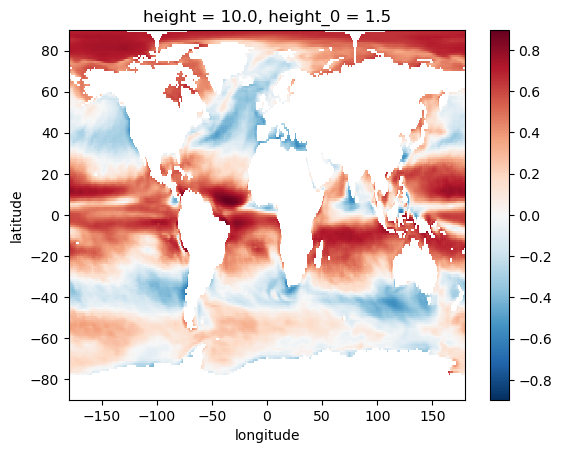

In [89]:
xs.pearson_r(VC, VC_pr, dim = "time").plot()

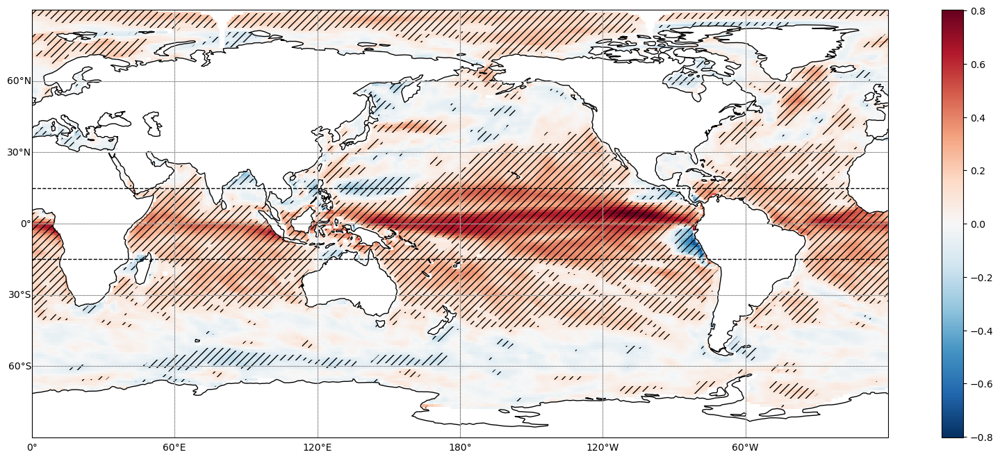

In [106]:
plt.figure(figsize = (20,8))
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
xs.pearson_r(VC_Tbias, VC_prbias, dim = "time").plot(transform=ccrs.PlateCarree())
p = xs.pearson_r_p_value(VC_Tbias, VC_prbias, dim = "time")
p.where(p<=0.05).plot.contourf(transform=ccrs.PlateCarree(),levels=[0, 0.05],
                                                                hatches=['///'], alpha = 0.0, add_colorbar=False)

ax.coastlines(color = 'k')
ax.axhline(y=-15, color='black', linestyle='--', linewidth=1)  # 15S
ax.axhline(y=15, color='black', linestyle='--', linewidth=1)
ax.gridlines()
#ax.set_facecolor('grey')
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')
gl.top_labels = False
gl.right_labels = False




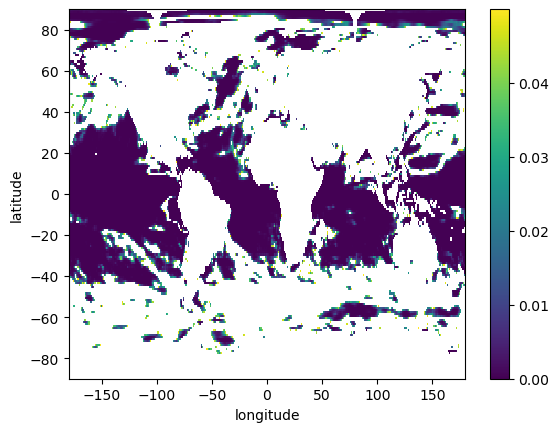

In [105]:
p = xs.pearson_r_p_value(VC_Tbias, VC_prbias, dim = "time")
p.where(p<=0.05).plot()